<a id='1'></a>

<table class="center" id="table1" style='color:white;font-size:30px;font-family:cursive;width:100%;margin-left:auto;margin-right:auto;'>
  <tr>
    <th style='border:3px solid #37a5fe;background-color:#37a5fe'>Table of Contents</th>
  </tr>
  <tr>
    <td style='border:3px solid #37a5fe;background-color:#57b1fa'><a href="#imports" style='color:white;font-size:20px;'><div>Import Libraries</div></a></td>
  </tr>
  <tr>
    <td style='border:3px solid #37a5fe;background-color:#57b1fa'><a href="#eda" style='color:white;font-size:20px;'><div>Exploratory Data Analysis (EDA)</div></a></td>
  </tr>
  <tr>
    <td style='border:3px solid #37a5fe;background-color:#57b1fa'><a href="#functions" style='color:white;font-size:20px;'><div>Set Up all the Necessary Functions</div></a></td>
  </tr>
  <tr>
      <td style='border:3px solid #37a5fe;background-color:#57b1fa;'><a href="#train" style='color:white;font-size:20px;'><div>Train Models:</div></a>
          <ol style='color:white;font-size:17px;background-color:#4a93ce'>
              <li style='border:3px solid #37a5fe;border-width: 3px 0 1px 0;'><a href="#custom" style='color:white;font-size:17px;'><div>My Custom Build Model</div></a></li>
              <li style='border:3px solid #37a5fe;border-width: 2px 0 2px 0;'><a href="#resnet18" style='color:white;font-size:17px;'><div>Resnet18</div></a></li>
              <li style='border:3px solid #37a5fe;border-width: 2px 0 2px 0;'><a href="#resnet50" style='color:white;font-size:17px;'><div>Resnet50</div></a></li>
              <li style='border:3px solid #37a5fe;border-width: 2px 0 2px 0;'><a href="#resnet152" style='color:white;font-size:17px;'><div>Resnet152</div></a></li>
              <li style='border:3px solid #37a5fe;border-width: 1px 0 2px 0;'><a href="#alexnet" style='color:white;font-size:17px;'><div>Alexnet</div></a></li>
              <li style='border:3px solid #37a5fe;border-width: 1px 0 2px 0;'><a href="#densenet" style='color:white;font-size:17px;'><div>Densenet</div></a></li>
          </ol>
      </td>
  </tr>
  <tr>
    <td style='border:3px solid #37a5fe;' bgcolor="#57b1fa"><a href="#choose" style='color:white;font-size:20px;'><div>Choose the Best Model</div></a></td>
  </tr>
</table>

<div style='border:5px solid #37a5fe; background-color:#37a5fe; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='imports' style='font-size:20px;font-weight:bold;color:white;'>Import Libraries</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

In [45]:
# working with directories
import os

# dataframe and arrays
import pandas as pd
import numpy as np

# track progress
from tqdm import tqdm
tqdm.pandas()

# sci-kit learn
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score

# For model building and dfing
import torch
import torchvision
from torchvision import models, transforms
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn


# reading images
from PIL import Image, ImageDraw, ImageFont

# plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = "notebook_connected"

# ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [2]:
# set up GPU device 
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [3]:
main_path = '/kaggle/input/weather-dataset/dataset'

weather_dict = {}
for w in os.listdir(main_path):
    for img in os.listdir(f"{main_path}/{w}"):
        weather_dict[img] = w

In [4]:
# set up a dataframe and get image names and respective weathers
df = pd.DataFrame.from_dict(weather_dict, orient='index')
df.reset_index(inplace=True)
df.columns = ['img_name', 'weather']
df = df.loc[:, ['weather', 'img_name']]

# get image paths
df['path'] = f'{main_path}/' + df.weather + '/' + df.img_name

# get image sizes
df['img_size'] = df.path.progress_apply(lambda x: np.asarray(Image.open(x)).shape)

# split img_size in width and height columns
df['height'] = df.img_size.str[0]
df['width'] = df.img_size.str[1]

100%|██████████| 6737/6737 [01:12<00:00, 92.61it/s] 


In [5]:
# Encode Weather classes with numenric values
le = LabelEncoder()
target = le.fit_transform(df['weather'])
df['target'] = target
le_inverse_mapping = dict(zip(le.transform(le.classes_), le.classes_))
le_inverse_mapping

{0: 'dew',
 1: 'fogsmog',
 2: 'frost',
 3: 'glaze',
 4: 'hail',
 5: 'lightning',
 6: 'rain',
 7: 'rainbow',
 8: 'rime',
 9: 'sandstorm',
 10: 'snow'}

<div style='border:5px solid #37a5fe; background-color:#37a5fe; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='eda' style='font-size:20px;font-weight:bold;color:white;'>Exploratory data analysis (EDA)</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

In [6]:
# Take a look at some rows
df.sample(10, random_state=42)

,weather,img_name,path,img_size,height,width,target
381,hail,0163.jpg,/kaggle/input/weather-dataset/dataset/hail/016...,"(176, 286, 3)",176,286,4
2476,fogsmog,4439.jpg,/kaggle/input/weather-dataset/dataset/fogsmog/...,"(177, 285, 3)",177,285,1
2855,fogsmog,4832.jpg,/kaggle/input/weather-dataset/dataset/fogsmog/...,"(266, 400, 3)",266,400,1
2018,rime,5444.jpg,/kaggle/input/weather-dataset/dataset/rime/544...,"(266, 400, 3)",266,400,8
2185,rime,5267.jpg,/kaggle/input/weather-dataset/dataset/rime/526...,"(188, 325, 3)",188,325,8
1894,rime,5486.jpg,/kaggle/input/weather-dataset/dataset/rime/548...,"(256, 397, 3)",256,397,8
2641,fogsmog,4752.jpg,/kaggle/input/weather-dataset/dataset/fogsmog/...,"(283, 400, 3)",283,400,1
503,hail,0016.jpg,/kaggle/input/weather-dataset/dataset/hail/001...,"(266, 400, 3)",266,400,4
6091,dew,2470.jpg,/kaggle/input/weather-dataset/dataset/dew/2470...,"(768, 1024, 3)",768,1024,0
2644,fogsmog,4538.jpg,/kaggle/input/weather-dataset/dataset/fogsmog/...,"(266, 400, 3)",266,400,1


In [7]:
# Check if all the images have the same extension
df.img_name.str.split('.').str[1].unique()

array(['jpg'], dtype=object)

In [8]:
grouped = df.groupby('weather')['img_name'].count().to_frame()
grouped.reset_index(inplace=True)
grouped.columns = ['Weather', 'Count']

In [9]:
fig = px.bar(
    grouped, 
    x='Weather', 
    y='Count', 
    title='<b>Number of images by each weather category</b>',
    color='Weather'
)

fig.update_layout(
    font_family="Courier New, monospace",
    font_size=12,
    font_color="#0c8df5",
    title_font_color="#0c8df5",
    title_font_family="Courier New, monospace",
)

fig.show()

<p style="background-color:#000099;color:white;font-style:italic;font-size:18px;">Not good. The classes are ubalanced. It's going to need some modification to solve the problem. We only need to balance training data so first we'll  split data and check training data class distribution. Then, balance the classes by resampling those with fewer images several times so that they gets about same amount of images as the one with the most images.</p>


In [10]:
# Split the data in train, valid and test dataframes
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42, shuffle=df.target)
test_df, valid_df = train_test_split(test_df, test_size=0.5, random_state=42, shuffle=df.target)

In [11]:
grouped = train_df.groupby('weather')['img_name'].count().to_frame()
grouped.reset_index(inplace=True)
grouped.columns = ['Weather', 'Count']

In [12]:
# Check Train data distribution
fig = px.pie(
    grouped, 
    values='Count', 
    names='Weather', 
    title='<b>Train Data Image Distribution by Classes</b>',
    color='Weather'
)

fig.update_layout(
    font_family="Courier New, monospace",
    font_size=12,
    font_color="#0c8df5",
    title_font_color="#0c8df5",
    title_font_family="Courier New, monospace",
)

fig.show()

<p style="background-color:#000099;color:white;font-style:italic;font-size:18px;">Seems like <i>rime</i> has most images (923). We'll resample others to have the images somewhere around that number.</p>


In [13]:
balancer = (train_df.weather.value_counts()[0]/train_df.weather.value_counts()).round()
balancer

rime         1.0
fogsmog      1.0
dew          2.0
sandstorm    2.0
glaze        2.0
hail         2.0
rain         2.0
snow         2.0
frost        2.0
lightning    3.0
rainbow      5.0
Name: weather, dtype: float64

In [14]:
# Balance dataframe
balanced_train_df = pd.DataFrame(columns = train_df.columns)
for idx in tqdm(balancer.index):
    temp_df = train_df[train_df.weather==idx]
    lst_of_dfs = [temp_df] * int(balancer[idx])
    balanced_train_df = pd.concat([balanced_train_df] + lst_of_dfs, axis=0)

100%|██████████| 11/11 [00:00<00:00, 402.88it/s]


In [15]:
grouped = balanced_train_df.groupby('weather')['img_name'].count().to_frame()
grouped.reset_index(inplace=True)
grouped.columns = ['Weather', 'Count']

In [16]:
# Check Train data distribution
fig = px.pie(
    grouped, 
    values='Count', 
    names='Weather', 
    title='<b>Train Data Image Distribution by Classes</b>',
    color='Weather'
)

fig.update_layout(
    font_family="Courier New, monospace",
    font_size=12,
    font_color="#0c8df5",
    title_font_color="#0c8df5",
    title_font_family="Courier New, monospace",
)

fig.show()

<p style="background-color:#000099;color:white;font-style:italic;font-size:18px;">Now it's more balanced. It should be good go.</p>


In [17]:
# define function to plot images
def image_plots(df, nrows, ncols, width, height, show_resolution=False, show_prediction=False, prediction_column=None):
    # create the figure
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(width, height))
    fig.tight_layout()
    
    # flatten axs so that we can easily access their indices
    axs = axs.flatten()
    
    # plot images
    for i, idx in enumerate(df.index):
        # stop if there are more images than rows*columns
        if i>nrows*ncols-1:
            break
        
        # open image
        path = df.loc[idx, 'path']
        img = Image.open(path).resize((700, 700)).convert("RGB")
        
        font = ImageFont.truetype("/kaggle/input/fonts-folder/Espera-Bold.ttf", 30)
        draw = ImageDraw.Draw(img, "RGBA")
        
        # CASE 1 (show Weather, Resolution and Prediction)
        if show_resolution==True and show_prediction==True:
            # draw rectange over image
            draw.rectangle(((0, 0), (350, 100)), fill=(0, 0, 0, 127))
            draw.rectangle(((0, 0), (350, 100)), outline=(0, 0, 0, 127), width=3)
            
            # add text
            draw.text((10, 10), 
                      f"Weather: {df.loc[idx, 'weather'].title()}\
                      \nPrediction: {df.loc[idx, prediction_column].title()}\
                      \nResolution: {df.loc[idx, 'img_size']}", 
                      font=font, 
                      fill='yellow') 
        
        # CASE 2 (show Weather and Resolution)
        elif show_resolution==True and show_prediction==False:
            # draw rectange over image
            draw.rectangle(((0, 0), (350, 75)), fill=(0, 0, 0, 127))
            draw.rectangle(((0, 0), (350, 75)), outline=(0, 0, 0, 127), width=3)
            
            # add text
            draw.text((10, 10), 
                      f"Weather: {df.loc[idx, 'weather'].title()}\
                      \nResolution: {df.loc[idx, 'img_size']}", 
                      font=font, 
                      fill='yellow')
        
        # CASE 3 (show Weather and Prediction)
        elif show_resolution==False and show_prediction==True:
            # draw rectange over image
            draw.rectangle(((0, 0), (300, 75)), fill=(0, 0, 0, 127))
            draw.rectangle(((0, 0), (300, 75)), outline=(0, 0, 0, 127), width=3)
            
            # add text
            draw.text((10, 10), 
                      f"Weather: {df.loc[idx, 'weather'].title()}\
                      \nPrediction: {df.loc[idx, prediction_column].title()}", 
                      font=font, 
                      fill='yellow')
            
        # CASE 4 (show only Weather)
        else:
            # draw rectange over image
            draw.rectangle(((0, 0), (300, 50)), fill=(0, 0, 0, 127))
            draw.rectangle(((0, 0), (300, 50)), outline=(0, 0, 0, 127), width=3)
            
            # add text
            draw.text((10, 10), 
                      f"Weather: {df.loc[idx, 'weather'].title()}", 
                      font=font, 
                      fill='yellow')
 
        
        axs[i].imshow(img)
        axs[i].axis('off')

    # Remove empty subplot
    for ax in axs.flat[df.shape[0]:]:
        ax.remove()
        
    # remove white spaces between subplots
    plt.subplots_adjust(wspace=0, hspace=0)

    plt.show;

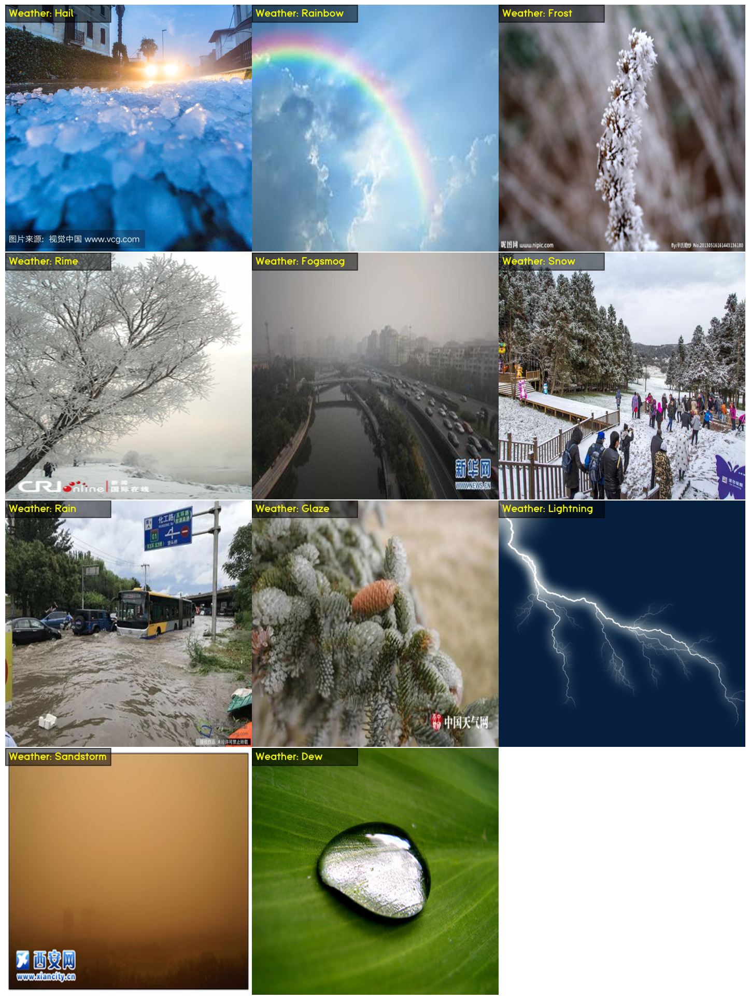

In [18]:
# get df of images we want to plot
images = df.groupby('weather').head(1)

image_plots(images, 4, 3, 15, 19.7)

<p style="background-color:#000099;color:white;font-style:italic;font-size:18px;">As it looks like even the images in this small sample have different resolutions. Let's plot all resolutions to get some idea and later we will resize these images to one size to train CNN model.</p>

In [19]:
fig = px.scatter(df, x='width', y='height', 
             title='<b>Image resolutions</b>', 
             color='width')

fig['layout'].update(height=600)

fig.show()

In [20]:
fig = make_subplots(
    rows=2, 
    cols=2,
    vertical_spacing = 0.1,
    horizontal_spacing = 0.1,
    subplot_titles=(
        "Width Distribution",
        "Height Distribution",
        )
)

# Figure 1
fig.add_trace(
    go.Histogram(
        x=df.width,
        showlegend=False
    ),
    row=1,
    col=1
)

fig['layout']['xaxis1']['title']='Width'
fig['layout']['yaxis1']['title']='Count'

# figure 2
fig.add_trace(
    go.Histogram(
        x=df.height,
        showlegend=False
    ),
    row=1,
    col=2
)

fig['layout']['xaxis2']['title']='Height'
fig['layout']['yaxis2']['title']='Count'

# figure 3
fig.add_trace(
    go.Box(
        y = df.width,
        name='',
        marker_color='#0c8df5',
        boxmean=True,
        showlegend=False
    ), 
    row=2, 
    col=1
)

fig['layout']['yaxis3']['title']='Width'

# figure 4
fig.add_trace(
    go.Box(
        y = df.height,
        name='',
        marker_color='#0c8df5',
        boxmean=True,
        showlegend=False
    ), 
    row=2, 
    col=2
)

fig['layout']['yaxis4']['title']='Height'
fig['layout'].update(height=1000, title='<b>Stacked Subplots with Shared X-Axes</b>')


fig.show()

<p style="background-color:#000099;color:white;font-style:italic;font-size:18px;">If we zoom and check distribution and box plots we can see that there are some outliers, for width they are outside both upper and lower fences, and for height they are above upper fence. We need to take a look at images with outliers. We will have to rescale images to the same sizes to train them.</p>

In [21]:
w_upper_fence, w_lower_fence = 650, 250
h_upper_fence, h_lower_fence = 616, 91

outliers_df = df.loc[
    (df['width']>w_upper_fence) | \
    (df['width']<w_lower_fence) | \
    (df['height']>h_upper_fence) | \
    (df['height']<h_upper_fence)
    ]

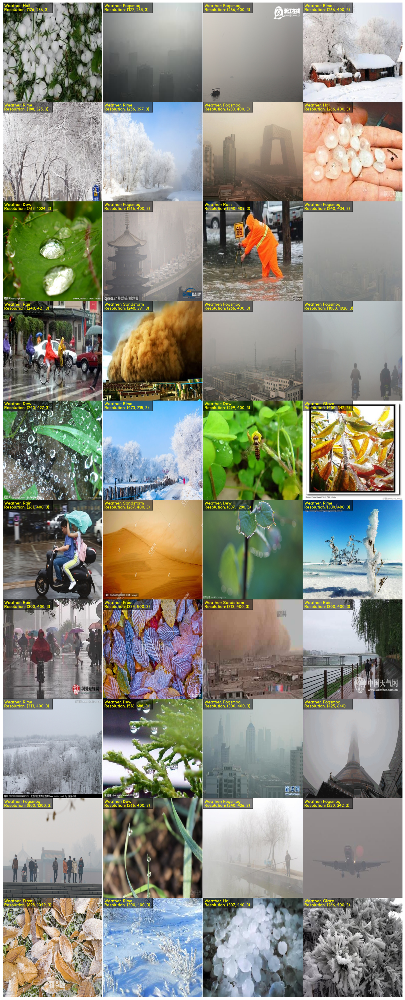

In [22]:
# get random sample of these outliers
outliers = outliers_df.sample(40, random_state=42)

# plot them
image_plots(outliers, 10, 4, 15, 36, show_resolution=True)

<p style="background-color:#000099;color:white;font-style:italic;font-weight:bold;font-size:18px;">Nothing looks weird with these outliers, they are indeed weather images but with higer resolution. Therefore we can rescale them with pillow and use in our model.</p>

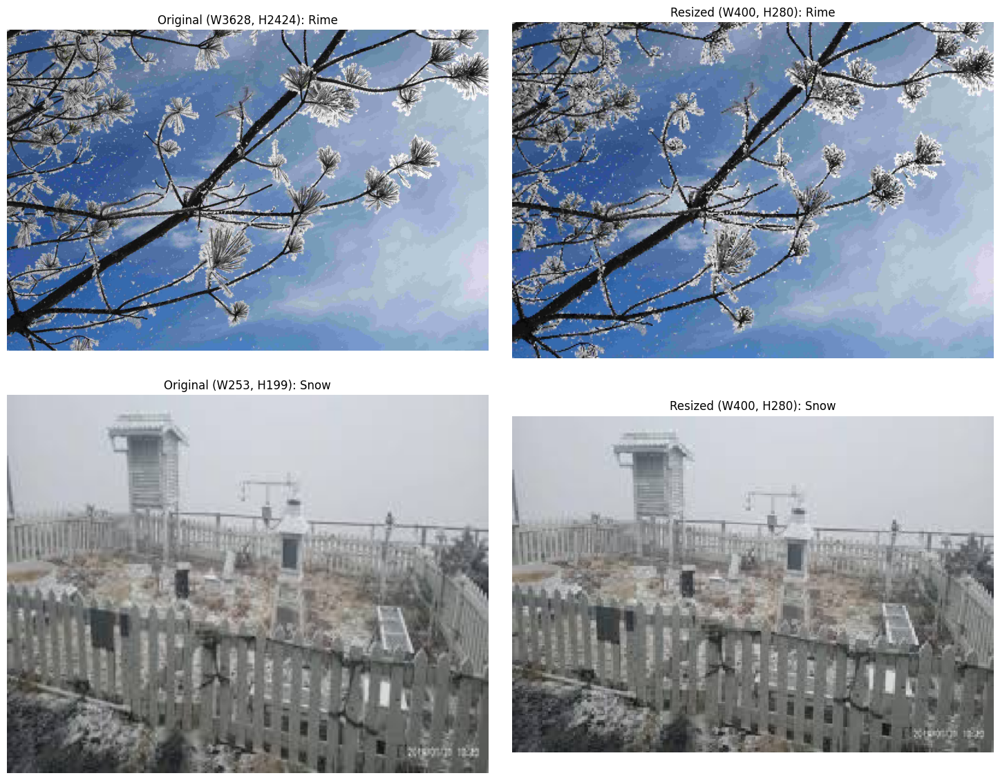

In [23]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15, 12))
fig.tight_layout()
ax = ax.flatten()
main_path = '/kaggle/input/weather-dataset/dataset'
ax[0].imshow(Image.open(f'{main_path}/rime/5425.jpg'))
ax[0].set_title('Original (W3628, H2424): Rime')
ax[0].axis('off')

ax[1].imshow(Image.open(f'{main_path}/rime/5425.jpg').resize((400, 280), Image.NEAREST))
ax[1].set_title('Resized (W400, H280): Rime')
ax[1].axis('off')

ax[2].imshow(Image.open(f'{main_path}/snow/0900.jpg'))
ax[2].set_title('Original (W253, H199): Snow')
ax[2].axis('off')

ax[3].imshow(Image.open(f'{main_path}/snow/0900.jpg').resize((400, 280), Image.NEAREST))
ax[3].set_title('Resized (W400, H280): Snow')
ax[3].axis('off')

fig.subplots_adjust(hspace=-0.25)
plt.subplots_adjust(wspace=.05, hspace=0)
plt.show;

<p style="background-color:#000099;color:white;font-style:italic;font-weight:bold;font-size:18px;">These show how ligh resolution and low resolution images will look like when we rescale them to median of all images height and width (280x400).</p>

In [24]:
# Check number channels of images
df.img_size.str[2].unique()

array([ 3., nan,  4.])

<p style="background-color:#000099;color:white;font-style:italic;font-weight:bold;font-size:18px;">Looks like we have 1 channel, 3 channels, and 4 channels images. We will convert them into 'RGB' format (3 channels) during Dataset creation.</p>

<div style='border:5px solid #37a5fe; background-color:#37a5fe; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='functions' style='font-size:20px;font-weight:bold;color:white;'>Set Up all the Necessary Functions</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

In [25]:
transform=transforms.RandomApply([
    transforms.RandomRotation(50),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomPerspective(distortion_scale=0.3, p=0.5),
])

In [26]:
# Define class that loads weather dataset, resizes and converts images to RGB, and turns them into tensors
class WeatherDataset(Dataset):
    def __init__(self, path, target, size: tuple, transform=None):
        self.size = size
        self.target = target
        self.path = path
        self.transform = transform
        
    def __len__(self):
        return len(self.target)

    def __getitem__(self, idx):
        img = Image.open(self.path[idx])
        img = img.convert('RGB').resize(self.size, Image.NEAREST)
        img = torch.tensor(np.asarray(img).reshape((3, self.size[0], self.size[1])), dtype=torch.float)
        img = img/255.
        if self.transform is not None:
            img=self.transform(img)
        return img, torch.tensor(self.target[idx])

In [27]:
# Define funtion to load datasets and dataloaders for train, valid, test separately
def dataset_dataloader(img_size:tuple, batch_size):
    train_dataset = WeatherDataset(balanced_train_df.path.values, balanced_train_df.target.values, img_size, transform)
    valid_dataset = WeatherDataset(valid_df.path.values, valid_df.target.values, img_size)
    test_dataset = WeatherDataset(test_df.path.values, test_df.target.values, img_size)
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(valid_dataset, batch_size=batch_size)
    test_loader = DataLoader(test_dataset, batch_size=len(test_dataset))
    return train_loader, valid_loader, test_loader

In [28]:
# Define funtion to train model on taining data from train_loader
def training(model, loss_criteria, optimizer, data_loader):
    # Set the model to training mode
    model.train()
    train_loss = 0
    correct = 0
    
    pbar_batch = tqdm(position=0, leave=True, desc='Training', total = len(data_loader))
    pbar_batch.reset()
    
    for batch, (inputs, target) in enumerate(data_loader):
        inputs, target = inputs.to(device), target.to(device)
        
        #feedforward
        optimizer.zero_grad()
        output = model(inputs)
        loss = loss_criteria(output, target)
        train_loss += loss.item()
        
        # backpropagate
        loss.backward()
        optimizer.step()
        
        # Calculate the accuracy
        predicted = output.argmax(axis=1)
        correct += torch.sum(target==predicted).item()

        pbar_batch.update(1)
    
    # calculate total training accuracy for this epoch
    accuracy = correct / len(data_loader.dataset)*100
    
    #Return average loss
    avg_loss = train_loss / (batch+1)
    
    print(f'Training loss: {avg_loss:.4f}, \
          Training accuracy: {correct}/{len(data_loader.dataset)} ({accuracy:.3f}%)\n')
    return avg_loss, accuracy

In [29]:
# Define funtion to validate trained model on validation data from valid_loader
def validation(model, loss_criteria, data_loader):
    # Switch the model to evaluation mode (so we don't backpropagate)
    model.eval()
    valid_loss = 0
    correct = 0
    
    with torch.no_grad():
        for batch, (inputs, target) in enumerate(data_loader):
            inputs, target = inputs.to(device), target.to(device)
            
            # Get the predictions
            output = model(inputs)

            # calculate the loss
            loss = loss_criteria(output, target)
            valid_loss += loss.item()

            # Calculate the accuracy
            predicted = output.argmax(axis=1)
            correct += torch.sum(target==predicted).item()
                        
    # Calculate total accuracy for this epoch
    accuracy = correct/len(data_loader.dataset)*100

    avg_loss = valid_loss / (batch+1)
    print(f'Validation loss: {avg_loss:.4f}, \
          Validation Accuracy: {correct}/{len(data_loader.dataset)} ({accuracy:.3f}%)\n')
   
    # return average loss for the epoch
    return avg_loss, accuracy

In [30]:
# Define function to conduct final testing on test_loader data and add predictions to test_df
def testing(test_loader, model_name, num_classes, batch_size, model_location, feature_extract):
    if model_name=='custom_model':
        model= nn.DataParallel(CNNModel(3, num_classes))
        model.to(device)
        model.load_state_dict(torch.load(model_location))
        
    elif model_name=='resnet18':
        model = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=False)
        model= nn.DataParallel(model)
        model.to(device)
        model.load_state_dict(torch.load(model_location))
        
    elif model_name=='resnet50':
        model = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=False)
        model= nn.DataParallel(model)
        model.to(device)
        model.load_state_dict(torch.load(model_location))
        
    elif model_name=='resnet152':
        model = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=False)
        model= nn.DataParallel(model)
        model.to(device)
        model.load_state_dict(torch.load(model_location))
    elif model_name=='alexnet':
        model = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=False)
        model= nn.DataParallel(model)
        model.to(device)
        model.load_state_dict(torch.load(model_location))

    elif model_name=='densenet':
        model = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=False)
        model= nn.DataParallel(model)
        model.to(device)
        model.load_state_dict(torch.load(model_location))
        
    else:
        print(f"We don't use no such model...")
        exit()
        
    # testing
    model.eval()
    with torch.no_grad():
        for batch, (inputs, target) in enumerate(test_loader):
            inputs, target = inputs.to(device), target.to(device)

            # Get the predictions
            output = model(inputs)
            predicted = output.argmax(axis=1)

    # add predictions to dataframe
    if model_name=='custom_model':
        test_df[f'{model_name}_prediction'] = predicted.cpu()
        test_df[f'{model_name}_prediction'] = test_df[f'{model_name}_prediction'].map(le_inverse_mapping)
    elif feature_extract:
        test_df[f'{model_name}_feature_extract_prediction'] = predicted.cpu()
        test_df[f'{model_name}_feature_extract_prediction'] = test_df[f'{model_name}_feature_extract_prediction'].map(le_inverse_mapping)
    else:
        test_df[f'{model_name}_fine_tuned_prediction'] = predicted.cpu()
        test_df[f'{model_name}_fine_tuned_prediction'] = test_df[f'{model_name}_fine_tuned_prediction'].map(le_inverse_mapping)

In [31]:
# Define a function that combines training and validation functions and repeats them for specified number of epochs, and saves the best model
def train_model(model, loss_criteria, optimizer, scheduler, train_loader, valid_loader, num_epochs, path, lr_decay):
    # just a large number that will be replaced by lower vaid loss
    best_model_valid_loss = 1e10 

    for epoch in range(1, num_epochs + 1):

        # print the epoch number
        print(f'Epoch: {epoch}')

        # Feed training data into the model to optimize the weights
        train_loss, train_accuracy = training(model, loss_criteria, optimizer, train_loader)
        if lr_decay==True:
            scheduler.step()

        # Feed the test data into the model to check its performance
        valid_loss, valid_accuracy = validation(model, loss_criteria, valid_loader)

        # Save model after each epoch
        if valid_loss < best_model_valid_loss:
            torch.save(model.state_dict(), path)
            best_model_valid_loss = valid_loss

In [38]:
# Visualize test results using classification report and confusion matrix
def visualize_results(model_name, feature_extract):
    print('\033[1m\033[91m'+'  CLASSIFICATION REPORT'+'\033[91m\033[0m', end='\n')
    
    if model_name == 'custom_model':
        print(classification_report(test_df['weather'], test_df[f'{model_name}_prediction']), end='\n\n')
        print('\033[1m\033[91m'+'  CONFUSION MATRIX'+'\033[91m\033[0m', end='\n')
        fig, ax = plt.subplots(figsize=(12,5))
        sns.heatmap(pd.crosstab(test_df[f'{model_name}_prediction'], test_df['weather']), cmap='Blues', ax=ax, annot=True, fmt=',.0f', vmax=100);
    elif feature_extract:
        print(classification_report(test_df['weather'], test_df[f'{model_name}_feature_extract_prediction']), end='\n\n')
        print('\033[1m\033[91m'+'  CONFUSION MATRIX'+'\033[91m\033[0m', end='\n')
        fig, ax = plt.subplots(figsize=(12,5))
        sns.heatmap(pd.crosstab(test_df[f'{model_name}_feature_extract_prediction'], test_df['weather']), cmap='Blues', ax=ax, annot=True, fmt=',.0f', vmax=100);
    else:
        print(classification_report(test_df['weather'], test_df[f'{model_name}_fine_tuned_prediction']), end='\n\n')
        print('\033[1m\033[91m'+'  CONFUSION MATRIX'+'\033[91m\033[0m', end='\n')
        fig, ax = plt.subplots(figsize=(12,5))
        sns.heatmap(pd.crosstab(test_df[f'{model_name}_fine_tuned_prediction'], test_df['weather']), cmap='Blues', ax=ax, annot=True, fmt=',.0f', vmax=100);

In [33]:
# Use this function to initialize pretrained models such as resnet, alexnet, vgg, squeezenet, densenet, inception
def initialize_model(model_name, num_classes, batch_size, feature_extract, use_pretrained=True, load_data=True):
    # Initialize these variables which will be set in this if statement. Each of these
    #   variables is model specific.
    model = None
    
    if model_name == "resnet18":
        """ Resnet18
        """
        model = models.resnet18(weights='ResNet18_Weights.DEFAULT')
        if feature_extract:
            for param in model.parameters():
                param.requires_grad = False
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, num_classes)
        if load_data == True:
            train_loader, valid_loader, test_loader = dataset_dataloader((224, 224), batch_size)
            
    elif model_name == "resnet50":
        """ Resnet50
        """
        model = models.resnet50(weights='ResNet50_Weights.DEFAULT')
        if feature_extract:
            for param in model.parameters():
                param.requires_grad = False
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, num_classes)
        if load_data == True:
            train_loader, valid_loader, test_loader = dataset_dataloader((224, 224), batch_size)
            
    elif model_name == "resnet152":
        """ Resnet152
        """
        model = models.resnet152(weights='ResNet152_Weights.DEFAULT')
        if feature_extract:
            for param in model.parameters():
                param.requires_grad = False
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, num_classes)
        if load_data == True:
            train_loader, valid_loader, test_loader = dataset_dataloader((224, 224), batch_size)
            
    elif model_name == "alexnet":
        """ Alexnet
        """
        model = models.alexnet(weights='AlexNet_Weights.DEFAULT')
        if feature_extract:
            for param in model.parameters():
                param.requires_grad = False
        num_ftrs = model.classifier[6].in_features
        model.classifier[6] = nn.Linear(num_ftrs,num_classes)
        if load_data == True:
            train_loader, valid_loader, test_loader = dataset_dataloader((224, 224), batch_size)

    elif model_name == "densenet":
        """ Densenet
        """
        model = models.densenet121(weights='DenseNet121_Weights.DEFAULT')
        if feature_extract:
            for param in model.parameters():
                param.requires_grad = False
        num_ftrs = model.classifier.in_features
        model.classifier = nn.Linear(num_ftrs, num_classes)
        if load_data == True:
            train_loader, valid_loader, test_loader = dataset_dataloader((224, 224), batch_size)

    else:
        print("Invalid model name, exiting...")
        exit()
    if load_data:
        return model, train_loader, valid_loader, test_loader
    else:
        return model

In [34]:
# Combine above functions
def stack_of_all_steps(model_name, num_classes, num_epochs, batch_size, learning_rate, img_size=None, lr_decay=False, feature_extract=True):
    if model_name == 'custom_model':
        train_loader, valid_loader, test_loader = dataset_dataloader(img_size, batch_size)
        model= nn.DataParallel(CNNModel(3, num_classes))
    else:
        model, train_loader, valid_loader, test_loader = initialize_model(model_name, num_classes, batch_size, feature_extract, load_data=True)
        model = nn.DataParallel(model)
    
    model.to(device)
    loss_criteria = nn.CrossEntropyLoss(reduction='mean')
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)
    
    # train & validate
    print('\033[1m'+'\033[94m'+'START TRAINING:'+'\033[94m'+'\033[0m', end='\n')
    if model_name == 'custom_model':
        train_model(model, loss_criteria, optimizer, scheduler, train_loader, valid_loader, num_epochs, f'/kaggle/working/{model_name}.pt', lr_decay=lr_decay)
    elif feature_extract:
        train_model(model, loss_criteria, optimizer, scheduler, train_loader, valid_loader, num_epochs, f'/kaggle/working/{model_name}_feature_extract.pt', lr_decay=lr_decay)
    else:
        train_model(model, loss_criteria, optimizer, scheduler, train_loader, valid_loader, num_epochs, f'/kaggle/working/{model_name}_fine_tuned.pt', lr_decay=lr_decay)
        
    # delete train and valid leader to free up some space
    del train_loader
    del valid_loader
    print('\033[1m'+'\033[94m'+'END TRAINING:'+'\033[94m'+'\033[0m', end='\n\n')

    # test
    print('\033[1m'+'\033[94m'+'START TESTING:'+'\033[94m'+'\033[0m', end='\n')
    if model_name == 'custom_model':
        testing(test_loader, model_name, num_classes, batch_size, f'/kaggle/working/{model_name}.pt', feature_extract)
    elif feature_extract:
        testing(test_loader, model_name, num_classes, batch_size, f'/kaggle/working/{model_name}_feature_extract.pt', feature_extract)
    else:
        testing(test_loader, model_name, num_classes, batch_size, f'/kaggle/working/{model_name}_fine_tuned.pt', feature_extract)
        
    # delete test loader and model and clear cache to free up some space
    del test_loader
    del model
    torch.cuda.empty_cache()
    
    print('\033[1m'+'\033[94m'+'END TESTING:'+'\033[94m'+'\033[0m', end='\n\n')
    
    # visualize
    print('\033[1m'+'\033[94m'+'VISUALIZE RESULTS:'+'\033[94m'+'\033[0m', end='\n')
    visualize_results(model_name, feature_extract)

<div style='border:5px solid #37a5fe; background-color:#37a5fe; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='train' style='font-size:20px;font-weight:bold;color:white;'>Train Models:</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

<div style='border:5px solid #5098d3;background-color:#4a93ce;color:white;border-radius:25px;text-align:center;font-family:cursive;'>
<h6><a id='custom' style='font-size:17px;font-weight:bold;color:white;'>My Custom Build Model</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

In [35]:
# Build model from scatch
class CNNModel(nn.Module):
    def __init__(self, num_channels, num_classes):
        super(CNNModel, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=num_channels, out_channels=20, kernel_size=(3, 3))
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=(3, 3), stride=(2, 2))

        self.conv2 = nn.Conv2d(in_channels=20, out_channels=50, kernel_size=(3, 3))
        self.relu2 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=(3, 3), stride=(2, 2))
        
        self.conv3 = nn.Conv2d(in_channels=50, out_channels=100, kernel_size=(3, 3))
        self.relu3 = nn.ReLU()
        self.maxpool3 = nn.MaxPool2d(kernel_size=(3, 3), stride=(2, 2))

        self.fc1 = nn.Linear(in_features=150400, out_features=1024)
        self.relu4 = nn.ReLU()
        self.dropout = nn.Dropout(0.5)
        
        self.fc2 = nn.Linear(in_features=1024, out_features=num_classes)
        self.logSoftmax = nn.LogSoftmax(dim=1)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)

        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)
        
        x = self.conv3(x)
        x = self.relu3(x)
        x = self.maxpool3(x)

        x = torch.flatten(x, 1)
        x = self.fc1(x)
        x = self.relu4(x)
        x = self.dropout(x)

        x = self.fc2(x)
        output = self.logSoftmax(x)

        return output

START TRAINING:
Epoch: 1


Training: 100%|██████████| 315/315 [03:10<00:00,  1.66it/s]


Training loss: 1.9024,           Training accuracy: 3239/10062 (32.190%)

Validation loss: 1.5220,           Validation Accuracy: 288/674 (42.730%)

Epoch: 2


Training: 100%|██████████| 315/315 [02:57<00:00,  1.77it/s]


Training loss: 1.6125,           Training accuracy: 4238/10062 (42.119%)

Validation loss: 1.5038,           Validation Accuracy: 322/674 (47.774%)

Epoch: 3


Training: 100%|██████████| 315/315 [02:55<00:00,  1.79it/s]


Training loss: 1.5382,           Training accuracy: 4579/10062 (45.508%)

Validation loss: 1.3528,           Validation Accuracy: 338/674 (50.148%)

Epoch: 4


Training: 100%|██████████| 315/315 [02:55<00:00,  1.79it/s]


Training loss: 1.4829,           Training accuracy: 4763/10062 (47.337%)

Validation loss: 1.3663,           Validation Accuracy: 353/674 (52.374%)

Epoch: 5


Training: 100%|██████████| 315/315 [02:58<00:00,  1.76it/s]


Training loss: 1.4500,           Training accuracy: 4845/10062 (48.151%)

Validation loss: 1.5852,           Validation Accuracy: 320/674 (47.478%)

Epoch: 6


Training: 100%|██████████| 315/315 [03:04<00:00,  1.71it/s]


Training loss: 1.4202,           Training accuracy: 4963/10062 (49.324%)

Validation loss: 1.3881,           Validation Accuracy: 360/674 (53.412%)

Epoch: 7


Training: 100%|██████████| 315/315 [02:58<00:00,  1.77it/s]


Training loss: 1.3945,           Training accuracy: 5119/10062 (50.875%)

Validation loss: 1.2740,           Validation Accuracy: 373/674 (55.341%)

Epoch: 8


Training: 100%|██████████| 315/315 [02:57<00:00,  1.77it/s]


Training loss: 1.2406,           Training accuracy: 5595/10062 (55.605%)

Validation loss: 1.2127,           Validation Accuracy: 392/674 (58.160%)

Epoch: 9


Training: 100%|██████████| 315/315 [02:59<00:00,  1.76it/s]


Training loss: 1.2093,           Training accuracy: 5743/10062 (57.076%)

Validation loss: 1.1774,           Validation Accuracy: 396/674 (58.754%)

Epoch: 10


Training: 100%|██████████| 315/315 [02:59<00:00,  1.76it/s]


Training loss: 1.1747,           Training accuracy: 5858/10062 (58.219%)

Validation loss: 1.1650,           Validation Accuracy: 402/674 (59.644%)

Epoch: 11


Training: 100%|██████████| 315/315 [02:57<00:00,  1.78it/s]


Training loss: 1.1761,           Training accuracy: 5905/10062 (58.686%)

Validation loss: 1.1531,           Validation Accuracy: 402/674 (59.644%)

Epoch: 12


Training: 100%|██████████| 315/315 [02:58<00:00,  1.76it/s]


Training loss: 1.1502,           Training accuracy: 5984/10062 (59.471%)

Validation loss: 1.1776,           Validation Accuracy: 402/674 (59.644%)

Epoch: 13


Training: 100%|██████████| 315/315 [02:58<00:00,  1.76it/s]


Training loss: 1.1367,           Training accuracy: 5997/10062 (59.600%)

Validation loss: 1.1640,           Validation Accuracy: 414/674 (61.424%)

Epoch: 14


Training: 100%|██████████| 315/315 [03:02<00:00,  1.73it/s]


Training loss: 1.1078,           Training accuracy: 6132/10062 (60.942%)

Validation loss: 1.1263,           Validation Accuracy: 419/674 (62.166%)

Epoch: 15


Training: 100%|██████████| 315/315 [02:57<00:00,  1.78it/s]


Training loss: 1.0817,           Training accuracy: 6212/10062 (61.737%)

Validation loss: 1.1226,           Validation Accuracy: 418/674 (62.018%)

Epoch: 16


Training: 100%|██████████| 315/315 [02:56<00:00,  1.79it/s]


Training loss: 1.0825,           Training accuracy: 6213/10062 (61.747%)

Validation loss: 1.1270,           Validation Accuracy: 421/674 (62.463%)

Epoch: 17


Training: 100%|██████████| 315/315 [02:56<00:00,  1.78it/s]


Training loss: 1.0671,           Training accuracy: 6274/10062 (62.353%)

Validation loss: 1.1312,           Validation Accuracy: 419/674 (62.166%)

Epoch: 18


Training: 100%|██████████| 315/315 [02:53<00:00,  1.81it/s]


Training loss: 1.0744,           Training accuracy: 6277/10062 (62.383%)

Validation loss: 1.1295,           Validation Accuracy: 423/674 (62.760%)

Epoch: 19


Training: 100%|██████████| 315/315 [02:54<00:00,  1.81it/s]


Training loss: 1.0579,           Training accuracy: 6286/10062 (62.473%)

Validation loss: 1.1331,           Validation Accuracy: 421/674 (62.463%)

Epoch: 20


Training: 100%|██████████| 315/315 [02:53<00:00,  1.82it/s]


Training loss: 1.0676,           Training accuracy: 6314/10062 (62.751%)

Validation loss: 1.1234,           Validation Accuracy: 425/674 (63.056%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.63      0.79      0.70        63
     fogsmog       0.86      0.78      0.81        85
       frost       0.50      0.46      0.48        50
       glaze       0.46      0.55      0.50        62
        hail       0.67      0.48      0.56        75
   lightning       0.72      0.76      0.74        34
        rain       0.42      0.58      0.49        45
     rainbow       0.45      0.56      0.50        25
        rime       0.81      0.63      0.71       113
   sandstorm       0.76      0.75      0.76        73
        snow       0.40      0.45      0.42        49

    accuracy                           0.63       674
   macro avg       0.61      0.62      0.61       674
weight

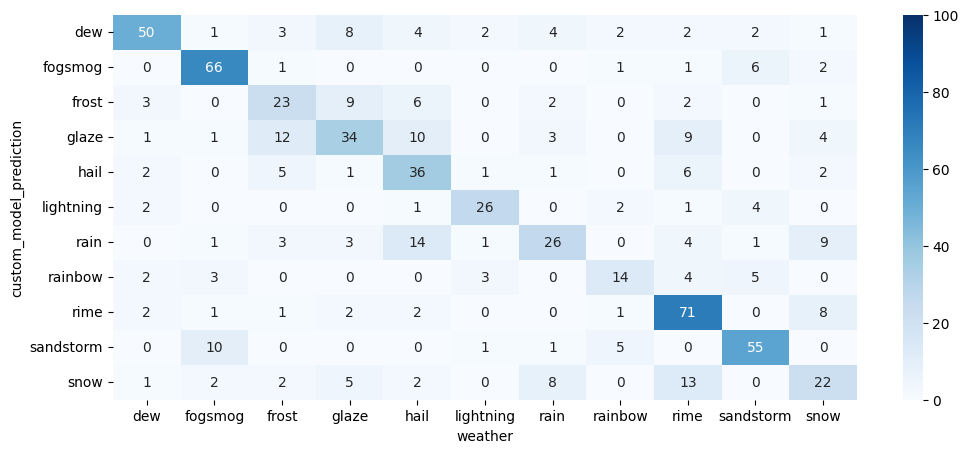

In [36]:
stack_of_all_steps(
    model_name='custom_model',
    num_classes=11,
    num_epochs=20,
    batch_size=32,
    learning_rate=0.001,
    img_size=(400, 280),
    lr_decay=True
)

<div style='border:5px solid #5098d3; background-color:#4a93ce; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='resnet18' style='font-size:17px;font-weight:bold;color:white;'>Resnet18</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:15<00:00,  2.09it/s]


Training loss: 1.7693,           Training accuracy: 3881/10062 (38.571%)

Validation loss: 1.3247,           Validation Accuracy: 367/674 (54.451%)

Epoch: 2


Training: 100%|██████████| 158/158 [01:14<00:00,  2.12it/s]


Training loss: 1.3877,           Training accuracy: 5200/10062 (51.680%)

Validation loss: 1.1330,           Validation Accuracy: 423/674 (62.760%)

Epoch: 3


Training: 100%|██████████| 158/158 [01:16<00:00,  2.06it/s]


Training loss: 1.3175,           Training accuracy: 5437/10062 (54.035%)

Validation loss: 1.1182,           Validation Accuracy: 410/674 (60.831%)

Epoch: 4


Training: 100%|██████████| 158/158 [01:16<00:00,  2.06it/s]


Training loss: 1.2617,           Training accuracy: 5636/10062 (56.013%)

Validation loss: 1.1301,           Validation Accuracy: 417/674 (61.869%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:16<00:00,  2.07it/s]


Training loss: 1.2366,           Training accuracy: 5694/10062 (56.589%)

Validation loss: 1.0492,           Validation Accuracy: 434/674 (64.392%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:16<00:00,  2.07it/s]


Training loss: 1.2140,           Training accuracy: 5719/10062 (56.838%)

Validation loss: 1.0634,           Validation Accuracy: 436/674 (64.688%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:16<00:00,  2.07it/s]


Training loss: 1.1810,           Training accuracy: 5883/10062 (58.468%)

Validation loss: 1.0814,           Validation Accuracy: 436/674 (64.688%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:15<00:00,  2.09it/s]


Training loss: 1.1562,           Training accuracy: 6011/10062 (59.740%)

Validation loss: 1.0138,           Validation Accuracy: 449/674 (66.617%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:14<00:00,  2.11it/s]


Training loss: 1.1586,           Training accuracy: 5988/10062 (59.511%)

Validation loss: 1.0303,           Validation Accuracy: 440/674 (65.282%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:13<00:00,  2.16it/s]


Training loss: 1.1376,           Training accuracy: 6055/10062 (60.177%)

Validation loss: 1.0307,           Validation Accuracy: 440/674 (65.282%)

Epoch: 11


Training: 100%|██████████| 158/158 [01:14<00:00,  2.13it/s]


Training loss: 1.1522,           Training accuracy: 6009/10062 (59.720%)

Validation loss: 1.0278,           Validation Accuracy: 440/674 (65.282%)

Epoch: 12


Training: 100%|██████████| 158/158 [01:14<00:00,  2.13it/s]


Training loss: 1.1385,           Training accuracy: 6068/10062 (60.306%)

Validation loss: 1.0061,           Validation Accuracy: 446/674 (66.172%)

Epoch: 13


Training: 100%|██████████| 158/158 [01:13<00:00,  2.14it/s]


Training loss: 1.1521,           Training accuracy: 6049/10062 (60.117%)

Validation loss: 1.0246,           Validation Accuracy: 448/674 (66.469%)

Epoch: 14


Training: 100%|██████████| 158/158 [01:13<00:00,  2.15it/s]


Training loss: 1.1335,           Training accuracy: 6097/10062 (60.594%)

Validation loss: 1.0160,           Validation Accuracy: 445/674 (66.024%)

Epoch: 15


Training: 100%|██████████| 158/158 [01:13<00:00,  2.14it/s]


Training loss: 1.1451,           Training accuracy: 6041/10062 (60.038%)

Validation loss: 1.0155,           Validation Accuracy: 442/674 (65.579%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.78      0.63      0.70        63
     fogsmog       0.72      0.78      0.75        85
       frost       0.51      0.42      0.46        50
       glaze       0.48      0.65      0.55        62
        hail       0.74      0.61      0.67        75
   lightning       0.85      0.97      0.90        34
        rain       0.54      0.60      0.57        45
     rainbow       0.73      0.76      0.75        25
        rime       0.76      0.77      0.77       113
   sandstorm       0.66      0.52      0.58        73
        snow       0.43      0.51      0.47        49

    accuracy                           0.66       674
   macro avg       0.65      0.66      0.65       674
weight

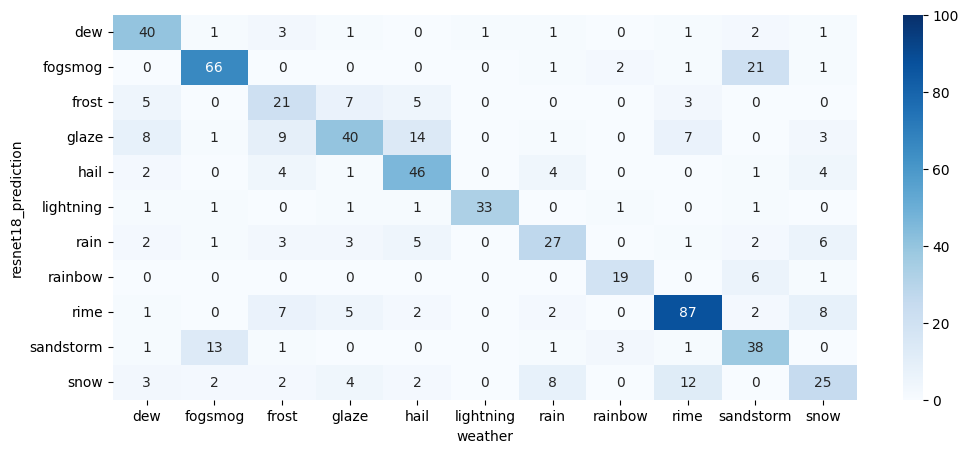

In [36]:
stack_of_all_steps(
    model_name='resnet18',
    num_classes=11,
    num_epochs=15,
    batch_size=64,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=True
)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 99.5MB/s]


START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [03:01<00:00,  1.15s/it]


Training loss: 1.4284,           Training accuracy: 4968/10062 (49.374%)

Validation loss: 1.1859,           Validation Accuracy: 405/674 (60.089%)

Epoch: 2


Training: 100%|██████████| 158/158 [02:54<00:00,  1.10s/it]


Training loss: 1.1439,           Training accuracy: 6089/10062 (60.515%)

Validation loss: 1.2985,           Validation Accuracy: 415/674 (61.573%)

Epoch: 3


Training: 100%|██████████| 158/158 [02:52<00:00,  1.09s/it]


Training loss: 1.0090,           Training accuracy: 6511/10062 (64.709%)

Validation loss: 1.3543,           Validation Accuracy: 369/674 (54.748%)

Epoch: 4


Training: 100%|██████████| 158/158 [02:49<00:00,  1.07s/it]


Training loss: 0.9125,           Training accuracy: 6880/10062 (68.376%)

Validation loss: 1.0987,           Validation Accuracy: 450/674 (66.766%)

Epoch: 5


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.8894,           Training accuracy: 6980/10062 (69.370%)

Validation loss: 0.9530,           Validation Accuracy: 476/674 (70.623%)

Epoch: 6


Training: 100%|██████████| 158/158 [02:57<00:00,  1.12s/it]


Training loss: 0.8048,           Training accuracy: 7258/10062 (72.133%)

Validation loss: 1.1611,           Validation Accuracy: 422/674 (62.611%)

Epoch: 7


Training: 100%|██████████| 158/158 [02:51<00:00,  1.08s/it]


Training loss: 0.7478,           Training accuracy: 7427/10062 (73.812%)

Validation loss: 0.7924,           Validation Accuracy: 502/674 (74.481%)

Epoch: 8


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.5734,           Training accuracy: 8087/10062 (80.372%)

Validation loss: 0.6168,           Validation Accuracy: 533/674 (79.080%)

Epoch: 9


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.5037,           Training accuracy: 8323/10062 (82.717%)

Validation loss: 0.5882,           Validation Accuracy: 552/674 (81.899%)

Epoch: 10


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.4711,           Training accuracy: 8429/10062 (83.771%)

Validation loss: 0.6044,           Validation Accuracy: 549/674 (81.454%)

Epoch: 11


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.4528,           Training accuracy: 8479/10062 (84.268%)

Validation loss: 0.6217,           Validation Accuracy: 548/674 (81.306%)

Epoch: 12


Training: 100%|██████████| 158/158 [02:49<00:00,  1.07s/it]


Training loss: 0.4470,           Training accuracy: 8516/10062 (84.635%)

Validation loss: 0.6171,           Validation Accuracy: 545/674 (80.861%)

Epoch: 13


Training: 100%|██████████| 158/158 [02:49<00:00,  1.08s/it]


Training loss: 0.4230,           Training accuracy: 8605/10062 (85.520%)

Validation loss: 0.6196,           Validation Accuracy: 555/674 (82.344%)

Epoch: 14


Training: 100%|██████████| 158/158 [02:49<00:00,  1.07s/it]


Training loss: 0.4206,           Training accuracy: 8629/10062 (85.758%)

Validation loss: 0.6533,           Validation Accuracy: 548/674 (81.306%)

Epoch: 15


Training: 100%|██████████| 158/158 [02:49<00:00,  1.07s/it]


Training loss: 0.3770,           Training accuracy: 8780/10062 (87.259%)

Validation loss: 0.6172,           Validation Accuracy: 549/674 (81.454%)

Epoch: 16


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.3714,           Training accuracy: 8814/10062 (87.597%)

Validation loss: 0.6038,           Validation Accuracy: 561/674 (83.234%)

Epoch: 17


Training: 100%|██████████| 158/158 [02:49<00:00,  1.08s/it]


Training loss: 0.3764,           Training accuracy: 8743/10062 (86.891%)

Validation loss: 0.6147,           Validation Accuracy: 552/674 (81.899%)

Epoch: 18


Training: 100%|██████████| 158/158 [02:49<00:00,  1.07s/it]


Training loss: 0.3685,           Training accuracy: 8811/10062 (87.567%)

Validation loss: 0.6114,           Validation Accuracy: 551/674 (81.751%)

Epoch: 19


Training: 100%|██████████| 158/158 [02:48<00:00,  1.07s/it]


Training loss: 0.3691,           Training accuracy: 8802/10062 (87.478%)

Validation loss: 0.5990,           Validation Accuracy: 555/674 (82.344%)

Epoch: 20


Training: 100%|██████████| 158/158 [02:50<00:00,  1.08s/it]


Training loss: 0.3650,           Training accuracy: 8819/10062 (87.647%)

Validation loss: 0.6027,           Validation Accuracy: 556/674 (82.493%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.82      0.95      0.88        63
     fogsmog       0.91      0.95      0.93        85
       frost       0.88      0.70      0.78        50
       glaze       0.72      0.76      0.74        62
        hail       0.88      0.87      0.87        75
   lightning       0.97      0.97      0.97        34
        rain       0.79      0.73      0.76        45
     rainbow       0.88      0.92      0.90        25
        rime       0.84      0.88      0.86       113
   sandstorm       0.93      0.89      0.91        73
        snow       0.63      0.55      0.59        49

    accuracy                           0.84       674
   macro avg       0.84      0.83      0.84       674
weight

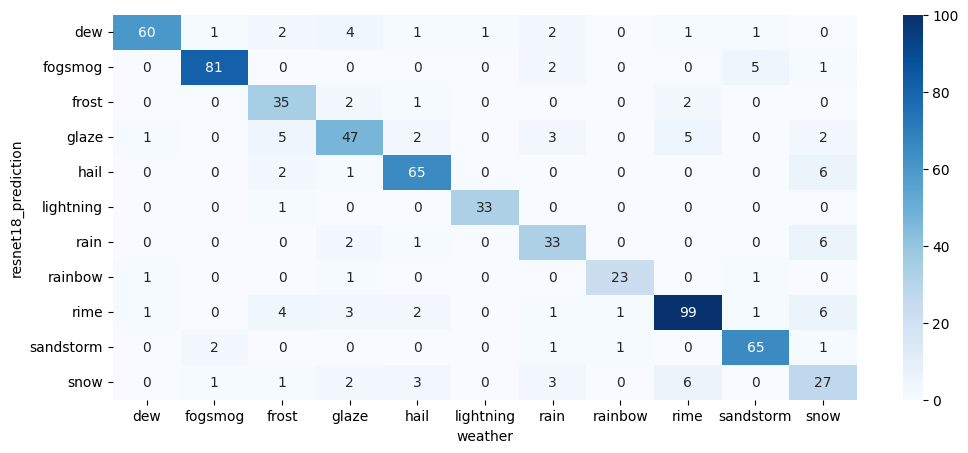

In [47]:
stack_of_all_steps(
    model_name='resnet18',
    num_classes=11,
    num_epochs=20,
    batch_size=64,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=False
)

<div style='border:5px solid #5098d3; background-color:#4a93ce; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='resnet50' style='font-size:17px;font-weight:bold;color:white;'>Resnet50</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:25<00:00,  1.84it/s]


Training loss: 1.6644,           Training accuracy: 4525/10062 (44.971%)

Validation loss: 1.2408,           Validation Accuracy: 416/674 (61.721%)

Epoch: 2


Training: 100%|██████████| 158/158 [01:24<00:00,  1.87it/s]


Training loss: 1.3278,           Training accuracy: 5539/10062 (55.049%)

Validation loss: 1.0842,           Validation Accuracy: 446/674 (66.172%)

Epoch: 3


Training: 100%|██████████| 158/158 [01:24<00:00,  1.86it/s]


Training loss: 1.2432,           Training accuracy: 5800/10062 (57.643%)

Validation loss: 1.0318,           Validation Accuracy: 456/674 (67.656%)

Epoch: 4


Training: 100%|██████████| 158/158 [01:24<00:00,  1.86it/s]


Training loss: 1.1835,           Training accuracy: 6009/10062 (59.720%)

Validation loss: 1.0179,           Validation Accuracy: 450/674 (66.766%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:24<00:00,  1.87it/s]


Training loss: 1.1350,           Training accuracy: 6165/10062 (61.270%)

Validation loss: 1.0403,           Validation Accuracy: 460/674 (68.249%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:25<00:00,  1.84it/s]


Training loss: 1.1338,           Training accuracy: 6191/10062 (61.529%)

Validation loss: 0.9944,           Validation Accuracy: 469/674 (69.585%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:24<00:00,  1.87it/s]


Training loss: 1.0848,           Training accuracy: 6253/10062 (62.145%)

Validation loss: 0.9821,           Validation Accuracy: 469/674 (69.585%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:24<00:00,  1.87it/s]


Training loss: 1.0750,           Training accuracy: 6376/10062 (63.367%)

Validation loss: 0.9282,           Validation Accuracy: 476/674 (70.623%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:25<00:00,  1.86it/s]


Training loss: 1.0492,           Training accuracy: 6438/10062 (63.983%)

Validation loss: 0.9833,           Validation Accuracy: 473/674 (70.178%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:25<00:00,  1.86it/s]


Training loss: 1.0396,           Training accuracy: 6395/10062 (63.556%)

Validation loss: 1.0030,           Validation Accuracy: 462/674 (68.546%)

Epoch: 11


Training: 100%|██████████| 158/158 [01:24<00:00,  1.86it/s]


Training loss: 1.0304,           Training accuracy: 6519/10062 (64.788%)

Validation loss: 0.9188,           Validation Accuracy: 483/674 (71.662%)

Epoch: 12


Training: 100%|██████████| 158/158 [01:25<00:00,  1.85it/s]


Training loss: 1.0350,           Training accuracy: 6468/10062 (64.281%)

Validation loss: 0.8991,           Validation Accuracy: 482/674 (71.513%)

Epoch: 13


Training: 100%|██████████| 158/158 [01:25<00:00,  1.84it/s]


Training loss: 1.0185,           Training accuracy: 6546/10062 (65.057%)

Validation loss: 0.9282,           Validation Accuracy: 480/674 (71.217%)

Epoch: 14


Training: 100%|██████████| 158/158 [01:25<00:00,  1.85it/s]


Training loss: 1.0123,           Training accuracy: 6536/10062 (64.957%)

Validation loss: 0.9500,           Validation Accuracy: 472/674 (70.030%)

Epoch: 15


Training: 100%|██████████| 158/158 [01:25<00:00,  1.84it/s]


Training loss: 1.0113,           Training accuracy: 6548/10062 (65.077%)

Validation loss: 0.9407,           Validation Accuracy: 484/674 (71.810%)

Epoch: 16


Training: 100%|██████████| 158/158 [01:26<00:00,  1.83it/s]


Training loss: 0.9927,           Training accuracy: 6604/10062 (65.633%)

Validation loss: 0.9371,           Validation Accuracy: 471/674 (69.881%)

Epoch: 17


Training: 100%|██████████| 158/158 [01:25<00:00,  1.84it/s]


Training loss: 0.9908,           Training accuracy: 6615/10062 (65.742%)

Validation loss: 0.9006,           Validation Accuracy: 480/674 (71.217%)

Epoch: 18


Training: 100%|██████████| 158/158 [01:25<00:00,  1.85it/s]


Training loss: 0.9786,           Training accuracy: 6637/10062 (65.961%)

Validation loss: 0.8803,           Validation Accuracy: 487/674 (72.255%)

Epoch: 19


Training: 100%|██████████| 158/158 [01:25<00:00,  1.86it/s]


Training loss: 0.9714,           Training accuracy: 6670/10062 (66.289%)

Validation loss: 0.9360,           Validation Accuracy: 466/674 (69.139%)

Epoch: 20


Training: 100%|██████████| 158/158 [01:25<00:00,  1.85it/s]


Training loss: 0.9659,           Training accuracy: 6714/10062 (66.726%)

Validation loss: 0.9462,           Validation Accuracy: 475/674 (70.475%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.70      0.75      0.72        63
     fogsmog       0.77      0.88      0.82        85
       frost       0.49      0.34      0.40        50
       glaze       0.49      0.71      0.58        62
        hail       0.75      0.67      0.70        75
   lightning       0.86      0.88      0.87        34
        rain       0.49      0.51      0.50        45
     rainbow       0.79      0.76      0.78        25
        rime       0.81      0.76      0.79       113
   sandstorm       0.80      0.67      0.73        73
        snow       0.56      0.51      0.53        49

    accuracy                           0.69       674
   macro avg       0.68      0.68      0.67       674
weight

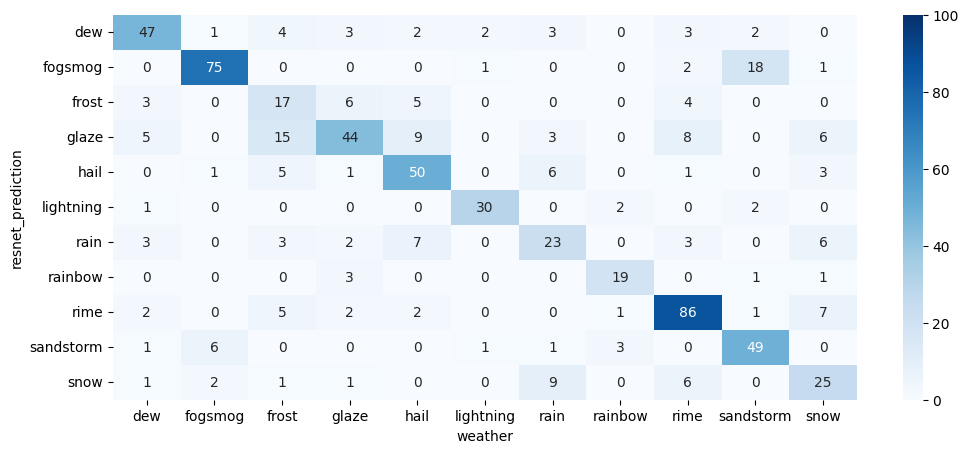

In [51]:
stack_of_all_steps(
    model_name='resnet50',
    num_classes=11,
    num_epochs=20,
    batch_size=64,
    learning_rate=0.001,
    feature_extract=True
)

START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [07:14<00:00,  2.75s/it]


Training loss: 1.3022,           Training accuracy: 5492/10062 (54.582%)

Validation loss: 0.9960,           Validation Accuracy: 442/674 (65.579%)

Epoch: 2


Training: 100%|██████████| 158/158 [07:12<00:00,  2.74s/it]


Training loss: 0.9332,           Training accuracy: 6785/10062 (67.432%)

Validation loss: 1.0002,           Validation Accuracy: 452/674 (67.062%)

Epoch: 3


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.7910,           Training accuracy: 7318/10062 (72.729%)

Validation loss: 0.7636,           Validation Accuracy: 502/674 (74.481%)

Epoch: 4


Training: 100%|██████████| 158/158 [07:10<00:00,  2.72s/it]


Training loss: 0.7011,           Training accuracy: 7578/10062 (75.313%)

Validation loss: 1.0025,           Validation Accuracy: 476/674 (70.623%)

Epoch: 5


Training: 100%|██████████| 158/158 [07:11<00:00,  2.73s/it]


Training loss: 0.6500,           Training accuracy: 7771/10062 (77.231%)

Validation loss: 0.8470,           Validation Accuracy: 486/674 (72.107%)

Epoch: 6


Training: 100%|██████████| 158/158 [07:12<00:00,  2.74s/it]


Training loss: 0.5896,           Training accuracy: 7970/10062 (79.209%)

Validation loss: 0.8077,           Validation Accuracy: 501/674 (74.332%)

Epoch: 7


Training: 100%|██████████| 158/158 [07:11<00:00,  2.73s/it]


Training loss: 0.5483,           Training accuracy: 8136/10062 (80.859%)

Validation loss: 0.9593,           Validation Accuracy: 490/674 (72.700%)

Epoch: 8


Training: 100%|██████████| 158/158 [07:12<00:00,  2.74s/it]


Training loss: 0.3853,           Training accuracy: 8769/10062 (87.150%)

Validation loss: 0.5832,           Validation Accuracy: 565/674 (83.828%)

Epoch: 9


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.3345,           Training accuracy: 8920/10062 (88.650%)

Validation loss: 0.5786,           Validation Accuracy: 567/674 (84.125%)

Epoch: 10


Training: 100%|██████████| 158/158 [07:10<00:00,  2.72s/it]


Training loss: 0.3027,           Training accuracy: 9020/10062 (89.644%)

Validation loss: 0.5906,           Validation Accuracy: 565/674 (83.828%)

Epoch: 11


Training: 100%|██████████| 158/158 [07:11<00:00,  2.73s/it]


Training loss: 0.2748,           Training accuracy: 9107/10062 (90.509%)

Validation loss: 0.5841,           Validation Accuracy: 570/674 (84.570%)

Epoch: 12


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2623,           Training accuracy: 9162/10062 (91.055%)

Validation loss: 0.5847,           Validation Accuracy: 574/674 (85.163%)

Epoch: 13


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2673,           Training accuracy: 9122/10062 (90.658%)

Validation loss: 0.6294,           Validation Accuracy: 570/674 (84.570%)

Epoch: 14


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2566,           Training accuracy: 9162/10062 (91.055%)

Validation loss: 0.6084,           Validation Accuracy: 571/674 (84.718%)

Epoch: 15


Training: 100%|██████████| 158/158 [07:13<00:00,  2.74s/it]


Training loss: 0.2276,           Training accuracy: 9309/10062 (92.516%)

Validation loss: 0.5838,           Validation Accuracy: 568/674 (84.273%)

Epoch: 16


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2225,           Training accuracy: 9309/10062 (92.516%)

Validation loss: 0.6005,           Validation Accuracy: 570/674 (84.570%)

Epoch: 17


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2200,           Training accuracy: 9294/10062 (92.367%)

Validation loss: 0.5895,           Validation Accuracy: 579/674 (85.905%)

Epoch: 18


Training: 100%|██████████| 158/158 [07:11<00:00,  2.73s/it]


Training loss: 0.2271,           Training accuracy: 9268/10062 (92.109%)

Validation loss: 0.5916,           Validation Accuracy: 574/674 (85.163%)

Epoch: 19


Training: 100%|██████████| 158/158 [07:10<00:00,  2.72s/it]


Training loss: 0.2304,           Training accuracy: 9288/10062 (92.308%)

Validation loss: 0.5901,           Validation Accuracy: 572/674 (84.866%)

Epoch: 20


Training: 100%|██████████| 158/158 [07:10<00:00,  2.72s/it]


Training loss: 0.2215,           Training accuracy: 9292/10062 (92.347%)

Validation loss: 0.5935,           Validation Accuracy: 577/674 (85.608%)

Epoch: 21


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2112,           Training accuracy: 9336/10062 (92.785%)

Validation loss: 0.5740,           Validation Accuracy: 575/674 (85.312%)

Epoch: 22


Training: 100%|██████████| 158/158 [07:12<00:00,  2.73s/it]


Training loss: 0.2176,           Training accuracy: 9304/10062 (92.467%)

Validation loss: 0.5919,           Validation Accuracy: 578/674 (85.757%)

Epoch: 23


Training: 100%|██████████| 158/158 [07:12<00:00,  2.74s/it]


Training loss: 0.2116,           Training accuracy: 9321/10062 (92.636%)

Validation loss: 0.5925,           Validation Accuracy: 576/674 (85.460%)

Epoch: 24


Training: 100%|██████████| 158/158 [07:12<00:00,  2.74s/it]


Training loss: 0.2108,           Training accuracy: 9334/10062 (92.765%)

Validation loss: 0.5900,           Validation Accuracy: 577/674 (85.608%)

Epoch: 25


Training: 100%|██████████| 158/158 [07:10<00:00,  2.73s/it]


Training loss: 0.2144,           Training accuracy: 9343/10062 (92.854%)

Validation loss: 0.6112,           Validation Accuracy: 567/674 (84.125%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.89      0.86      0.87        63
     fogsmog       0.87      0.99      0.92        85
       frost       0.85      0.80      0.82        50
       glaze       0.79      0.74      0.77        62
        hail       0.90      0.87      0.88        75
   lightning       0.92      0.97      0.94        34
        rain       0.70      0.71      0.70        45
     rainbow       0.96      0.88      0.92        25
        rime       0.83      0.85      0.84       113
   sandstorm       0.92      0.92      0.92        73
        snow       0.67      0.61      0.64        49

    accuracy                           0.84       674
   macro avg       0.84      0.84      0.84       674
weight

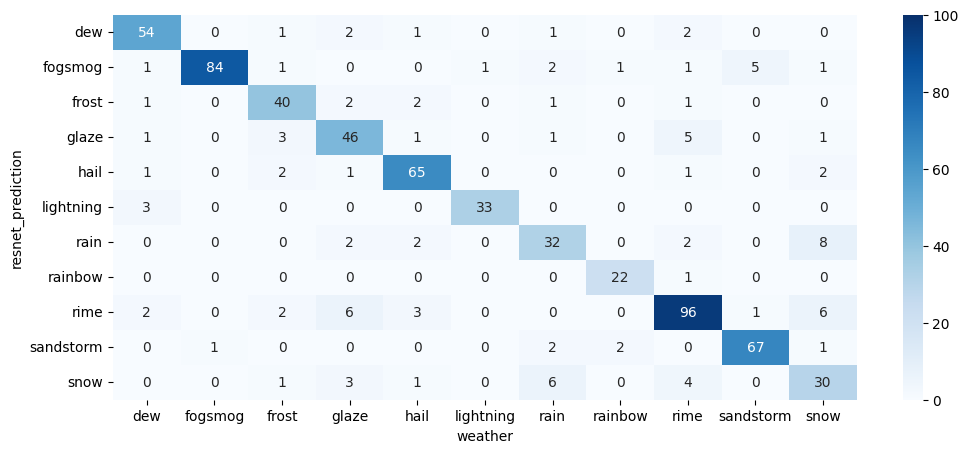

In [53]:
stack_of_all_steps(
    model_name='resnet50',
    num_classes=11,
    num_epochs=25,
    batch_size=64,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=False
)

<div style='border:5px solid #5098d3; background-color:#4a93ce; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='resnet152' style='font-size:17px;font-weight:bold;color:white;'>Resnet152</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

Downloading: "https://download.pytorch.org/models/resnet152-f82ba261.pth" to /root/.cache/torch/hub/checkpoints/resnet152-f82ba261.pth
100%|██████████| 230M/230M [00:00<00:00, 253MB/s] 


START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:59<00:00,  1.32it/s]


Training loss: 1.6277,           Training accuracy: 4652/10062 (46.233%)

Validation loss: 1.2006,           Validation Accuracy: 434/674 (64.392%)

Epoch: 2


Training: 100%|██████████| 158/158 [02:00<00:00,  1.31it/s]


Training loss: 1.2687,           Training accuracy: 5844/10062 (58.080%)

Validation loss: 1.0923,           Validation Accuracy: 445/674 (66.024%)

Epoch: 3


Training: 100%|██████████| 158/158 [02:00<00:00,  1.31it/s]


Training loss: 1.1698,           Training accuracy: 6091/10062 (60.535%)

Validation loss: 1.0205,           Validation Accuracy: 462/674 (68.546%)

Epoch: 4


Training: 100%|██████████| 158/158 [02:01<00:00,  1.30it/s]


Training loss: 1.1204,           Training accuracy: 6262/10062 (62.234%)

Validation loss: 0.9687,           Validation Accuracy: 472/674 (70.030%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:58<00:00,  1.33it/s]


Training loss: 1.0730,           Training accuracy: 6398/10062 (63.586%)

Validation loss: 0.9568,           Validation Accuracy: 473/674 (70.178%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:59<00:00,  1.33it/s]


Training loss: 1.0511,           Training accuracy: 6467/10062 (64.272%)

Validation loss: 0.9493,           Validation Accuracy: 468/674 (69.436%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:59<00:00,  1.32it/s]


Training loss: 1.0320,           Training accuracy: 6543/10062 (65.027%)

Validation loss: 0.9203,           Validation Accuracy: 485/674 (71.958%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:59<00:00,  1.32it/s]


Training loss: 1.0035,           Training accuracy: 6595/10062 (65.544%)

Validation loss: 0.9181,           Validation Accuracy: 490/674 (72.700%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:58<00:00,  1.33it/s]


Training loss: 1.0045,           Training accuracy: 6626/10062 (65.852%)

Validation loss: 0.9136,           Validation Accuracy: 478/674 (70.920%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:58<00:00,  1.33it/s]


Training loss: 0.9882,           Training accuracy: 6717/10062 (66.756%)

Validation loss: 0.9342,           Validation Accuracy: 473/674 (70.178%)

Epoch: 11


Training: 100%|██████████| 158/158 [01:57<00:00,  1.34it/s]


Training loss: 0.9936,           Training accuracy: 6699/10062 (66.577%)

Validation loss: 0.9044,           Validation Accuracy: 480/674 (71.217%)

Epoch: 12


Training: 100%|██████████| 158/158 [01:58<00:00,  1.33it/s]


Training loss: 0.9908,           Training accuracy: 6669/10062 (66.279%)

Validation loss: 0.9096,           Validation Accuracy: 480/674 (71.217%)

Epoch: 13


Training: 100%|██████████| 158/158 [01:58<00:00,  1.33it/s]


Training loss: 0.9833,           Training accuracy: 6698/10062 (66.567%)

Validation loss: 0.9190,           Validation Accuracy: 478/674 (70.920%)

Epoch: 14


Training: 100%|██████████| 158/158 [01:57<00:00,  1.34it/s]


Training loss: 0.9991,           Training accuracy: 6667/10062 (66.259%)

Validation loss: 0.9003,           Validation Accuracy: 487/674 (72.255%)

Epoch: 15


Training: 100%|██████████| 158/158 [01:58<00:00,  1.34it/s]


Training loss: 0.9775,           Training accuracy: 6741/10062 (66.995%)

Validation loss: 0.9193,           Validation Accuracy: 480/674 (71.217%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.75      0.78      0.77        63
     fogsmog       0.79      0.84      0.81        85
       frost       0.50      0.46      0.48        50
       glaze       0.56      0.66      0.61        62
        hail       0.74      0.65      0.70        75
   lightning       0.89      0.94      0.91        34
        rain       0.55      0.67      0.60        45
     rainbow       0.79      0.76      0.78        25
        rime       0.82      0.73      0.78       113
   sandstorm       0.74      0.71      0.73        73
        snow       0.52      0.51      0.52        49

    accuracy                           0.70       674
   macro avg       0.70      0.70      0.70       674
weight

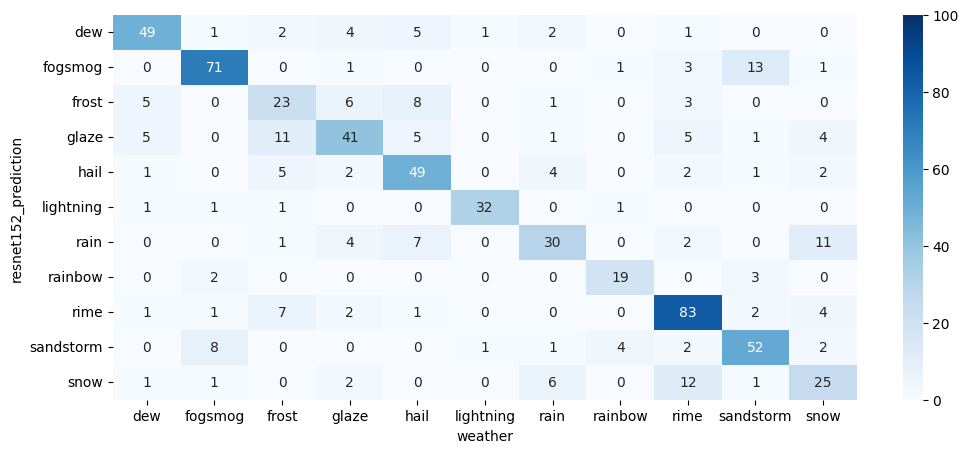

In [37]:
stack_of_all_steps(
    model_name='resnet152',
    num_classes=11,
    num_epochs=15,
    batch_size=64,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=True
)

Downloading: "https://download.pytorch.org/models/resnet152-f82ba261.pth" to /root/.cache/torch/hub/checkpoints/resnet152-f82ba261.pth
100%|██████████| 230M/230M [00:03<00:00, 80.1MB/s] 


START TRAINING:
Epoch: 1


Training: 100%|██████████| 79/79 [12:32<00:00,  9.53s/it]


Training loss: 1.1091,           Training accuracy: 6197/10062 (61.588%)

Validation loss: 1.0266,           Validation Accuracy: 470/674 (69.733%)

Epoch: 2


Training: 100%|██████████| 79/79 [12:24<00:00,  9.43s/it]


Training loss: 0.7410,           Training accuracy: 7461/10062 (74.150%)

Validation loss: 0.7548,           Validation Accuracy: 512/674 (75.964%)

Epoch: 3


Training: 100%|██████████| 79/79 [12:28<00:00,  9.47s/it]


Training loss: 0.6022,           Training accuracy: 7935/10062 (78.861%)

Validation loss: 1.3214,           Validation Accuracy: 442/674 (65.579%)

Epoch: 4


Training: 100%|██████████| 79/79 [12:25<00:00,  9.43s/it]


Training loss: 0.5199,           Training accuracy: 8231/10062 (81.803%)

Validation loss: 0.8113,           Validation Accuracy: 534/674 (79.228%)

Epoch: 5


Training: 100%|██████████| 79/79 [12:28<00:00,  9.47s/it]


Training loss: 0.4621,           Training accuracy: 8446/10062 (83.940%)

Validation loss: 0.6860,           Validation Accuracy: 542/674 (80.415%)

Epoch: 6


Training: 100%|██████████| 79/79 [12:28<00:00,  9.47s/it]


Training loss: 0.4106,           Training accuracy: 8643/10062 (85.897%)

Validation loss: 0.7961,           Validation Accuracy: 530/674 (78.635%)

Epoch: 7


Training: 100%|██████████| 79/79 [12:28<00:00,  9.48s/it]


Training loss: 0.3795,           Training accuracy: 8703/10062 (86.494%)

Validation loss: 0.7550,           Validation Accuracy: 531/674 (78.783%)

Epoch: 8


Training: 100%|██████████| 79/79 [12:25<00:00,  9.44s/it]


Training loss: 0.2527,           Training accuracy: 9193/10062 (91.364%)

Validation loss: 0.5686,           Validation Accuracy: 563/674 (83.531%)

Epoch: 9


Training: 100%|██████████| 79/79 [12:29<00:00,  9.49s/it]


Training loss: 0.1955,           Training accuracy: 9371/10062 (93.133%)

Validation loss: 0.5849,           Validation Accuracy: 566/674 (83.976%)

Epoch: 10


Training: 100%|██████████| 79/79 [12:28<00:00,  9.47s/it]


Training loss: 0.1740,           Training accuracy: 9484/10062 (94.256%)

Validation loss: 0.6182,           Validation Accuracy: 566/674 (83.976%)

Epoch: 11


Training: 100%|██████████| 79/79 [12:29<00:00,  9.48s/it]


Training loss: 0.1682,           Training accuracy: 9480/10062 (94.216%)

Validation loss: 0.6233,           Validation Accuracy: 572/674 (84.866%)

Epoch: 12


Training: 100%|██████████| 79/79 [12:29<00:00,  9.49s/it]


Training loss: 0.1566,           Training accuracy: 9506/10062 (94.474%)

Validation loss: 0.6865,           Validation Accuracy: 571/674 (84.718%)

Epoch: 13


Training: 100%|██████████| 79/79 [12:30<00:00,  9.50s/it]


Training loss: 0.1459,           Training accuracy: 9547/10062 (94.882%)

Validation loss: 0.6605,           Validation Accuracy: 565/674 (83.828%)

Epoch: 14


Training: 100%|██████████| 79/79 [12:31<00:00,  9.52s/it]


Training loss: 0.1308,           Training accuracy: 9603/10062 (95.438%)

Validation loss: 0.6705,           Validation Accuracy: 562/674 (83.383%)

Epoch: 15


Training: 100%|██████████| 79/79 [12:32<00:00,  9.53s/it]


Training loss: 0.1183,           Training accuracy: 9649/10062 (95.895%)

Validation loss: 0.6553,           Validation Accuracy: 567/674 (84.125%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.95      0.90      0.93        63
     fogsmog       0.89      0.92      0.90        85
       frost       0.80      0.72      0.76        50
       glaze       0.74      0.74      0.74        62
        hail       0.91      0.85      0.88        75
   lightning       0.94      1.00      0.97        34
        rain       0.69      0.78      0.73        45
     rainbow       1.00      0.92      0.96        25
        rime       0.87      0.86      0.87       113
   sandstorm       0.86      0.86      0.86        73
        snow       0.56      0.63      0.60        49

    accuracy                           0.84       674
   macro avg       0.84      0.84      0.84       674
weight

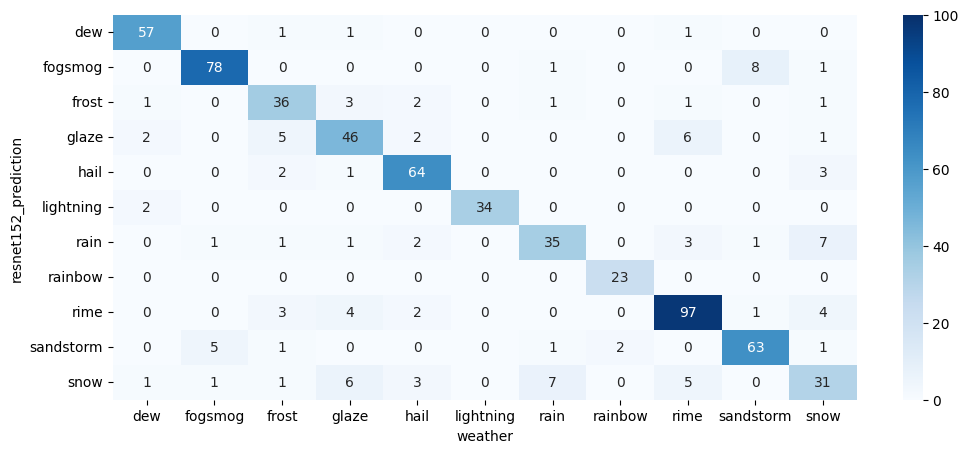

In [35]:
stack_of_all_steps(
    model_name='resnet152',
    num_classes=11,
    num_epochs=15,
    batch_size=128,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=False
)

<div style='border:5px solid #5098d3; background-color:#4a93ce; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='alexnet' style='font-size:17px;font-weight:bold;color:white;'>Alexnet</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:14<00:00,  2.12it/s]


Training loss: 1.7729,           Training accuracy: 3368/10062 (33.472%)

Validation loss: 1.3807,           Validation Accuracy: 345/674 (51.187%)

Epoch: 2


Training: 100%|██████████| 158/158 [01:14<00:00,  2.11it/s]


Training loss: 1.6280,           Training accuracy: 4018/10062 (39.932%)

Validation loss: 1.3617,           Validation Accuracy: 347/674 (51.484%)

Epoch: 3


Training: 100%|██████████| 158/158 [01:16<00:00,  2.07it/s]


Training loss: 1.6274,           Training accuracy: 4105/10062 (40.797%)

Validation loss: 1.3345,           Validation Accuracy: 363/674 (53.858%)

Epoch: 4


Training: 100%|██████████| 158/158 [01:16<00:00,  2.07it/s]


Training loss: 1.6308,           Training accuracy: 4063/10062 (40.380%)

Validation loss: 1.3095,           Validation Accuracy: 369/674 (54.748%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:14<00:00,  2.12it/s]


Training loss: 1.6013,           Training accuracy: 4185/10062 (41.592%)

Validation loss: 1.3919,           Validation Accuracy: 318/674 (47.181%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:14<00:00,  2.11it/s]


Training loss: 1.5794,           Training accuracy: 4251/10062 (42.248%)

Validation loss: 1.2847,           Validation Accuracy: 384/674 (56.973%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:14<00:00,  2.11it/s]


Training loss: 1.5916,           Training accuracy: 4201/10062 (41.751%)

Validation loss: 1.3982,           Validation Accuracy: 316/674 (46.884%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:15<00:00,  2.11it/s]


Training loss: 1.5818,           Training accuracy: 4309/10062 (42.824%)

Validation loss: 1.2536,           Validation Accuracy: 391/674 (58.012%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:16<00:00,  2.08it/s]


Training loss: 1.5884,           Training accuracy: 4327/10062 (43.003%)

Validation loss: 1.2955,           Validation Accuracy: 366/674 (54.303%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:17<00:00,  2.05it/s]


Training loss: 1.5826,           Training accuracy: 4319/10062 (42.924%)

Validation loss: 1.3033,           Validation Accuracy: 341/674 (50.593%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.68      0.54      0.60        63
     fogsmog       0.68      0.61      0.64        85
       frost       0.35      0.44      0.39        50
       glaze       0.53      0.37      0.44        62
        hail       0.46      0.73      0.56        75
   lightning       0.71      0.71      0.71        34
        rain       0.53      0.44      0.48        45
     rainbow       0.40      0.76      0.52        25
        rime       0.69      0.66      0.68       113
   sandstorm       0.50      0.48      0.49        73
        snow       0.45      0.20      0.28        49

    accuracy                           0.55       674
   macro avg       0.54      0.54      0.53       674
weight

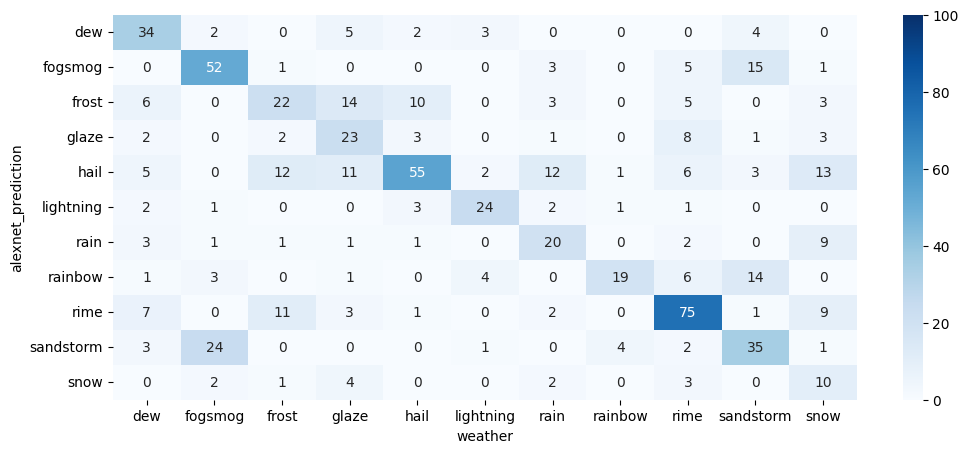

In [55]:
stack_of_all_steps(
    model_name='alexnet',
    num_classes=11,
    num_epochs=10,
    batch_size=64,
    learning_rate=0.001,
    feature_extract=True
)

START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:20<00:00,  1.96it/s]


Training loss: 1.9823,           Training accuracy: 2800/10062 (27.827%)

Validation loss: 1.6002,           Validation Accuracy: 274/674 (40.653%)

Epoch: 2


Training: 100%|██████████| 158/158 [01:20<00:00,  1.97it/s]


Training loss: 1.6827,           Training accuracy: 3839/10062 (38.153%)

Validation loss: 1.5967,           Validation Accuracy: 290/674 (43.027%)

Epoch: 3


Training: 100%|██████████| 158/158 [01:20<00:00,  1.95it/s]


Training loss: 1.5868,           Training accuracy: 4174/10062 (41.483%)

Validation loss: 1.3610,           Validation Accuracy: 356/674 (52.819%)

Epoch: 4


Training: 100%|██████████| 158/158 [01:21<00:00,  1.95it/s]


Training loss: 1.5286,           Training accuracy: 4401/10062 (43.739%)

Validation loss: 1.3774,           Validation Accuracy: 355/674 (52.671%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:21<00:00,  1.94it/s]


Training loss: 1.4796,           Training accuracy: 4640/10062 (46.114%)

Validation loss: 1.3738,           Validation Accuracy: 341/674 (50.593%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:22<00:00,  1.92it/s]


Training loss: 1.4322,           Training accuracy: 4897/10062 (48.668%)

Validation loss: 1.2726,           Validation Accuracy: 376/674 (55.786%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:21<00:00,  1.95it/s]


Training loss: 1.4114,           Training accuracy: 4939/10062 (49.086%)

Validation loss: 1.2711,           Validation Accuracy: 399/674 (59.199%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:21<00:00,  1.94it/s]


Training loss: 1.2486,           Training accuracy: 5489/10062 (54.552%)

Validation loss: 1.1365,           Validation Accuracy: 417/674 (61.869%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:22<00:00,  1.93it/s]


Training loss: 1.2066,           Training accuracy: 5639/10062 (56.043%)

Validation loss: 1.1523,           Validation Accuracy: 407/674 (60.386%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:21<00:00,  1.95it/s]


Training loss: 1.1731,           Training accuracy: 5782/10062 (57.464%)

Validation loss: 1.1154,           Validation Accuracy: 418/674 (62.018%)

Epoch: 11


Training: 100%|██████████| 158/158 [01:20<00:00,  1.95it/s]


Training loss: 1.1566,           Training accuracy: 5848/10062 (58.120%)

Validation loss: 1.0975,           Validation Accuracy: 428/674 (63.501%)

Epoch: 12


Training: 100%|██████████| 158/158 [01:21<00:00,  1.94it/s]


Training loss: 1.1340,           Training accuracy: 5956/10062 (59.193%)

Validation loss: 1.1014,           Validation Accuracy: 424/674 (62.908%)

Epoch: 13


Training: 100%|██████████| 158/158 [01:21<00:00,  1.94it/s]


Training loss: 1.1333,           Training accuracy: 5935/10062 (58.984%)

Validation loss: 1.0619,           Validation Accuracy: 444/674 (65.875%)

Epoch: 14


Training: 100%|██████████| 158/158 [01:21<00:00,  1.94it/s]


Training loss: 1.0995,           Training accuracy: 6078/10062 (60.405%)

Validation loss: 1.0654,           Validation Accuracy: 436/674 (64.688%)

Epoch: 15


Training: 100%|██████████| 158/158 [01:20<00:00,  1.95it/s]


Training loss: 1.0800,           Training accuracy: 6144/10062 (61.061%)

Validation loss: 1.0411,           Validation Accuracy: 443/674 (65.727%)

Epoch: 16


Training: 100%|██████████| 158/158 [01:20<00:00,  1.97it/s]


Training loss: 1.0610,           Training accuracy: 6209/10062 (61.707%)

Validation loss: 1.0422,           Validation Accuracy: 446/674 (66.172%)

Epoch: 17


Training: 100%|██████████| 158/158 [01:20<00:00,  1.97it/s]


Training loss: 1.0604,           Training accuracy: 6229/10062 (61.906%)

Validation loss: 1.0429,           Validation Accuracy: 441/674 (65.430%)

Epoch: 18


Training: 100%|██████████| 158/158 [01:20<00:00,  1.96it/s]


Training loss: 1.0585,           Training accuracy: 6230/10062 (61.916%)

Validation loss: 1.0390,           Validation Accuracy: 442/674 (65.579%)

Epoch: 19


Training: 100%|██████████| 158/158 [01:21<00:00,  1.95it/s]


Training loss: 1.0543,           Training accuracy: 6237/10062 (61.986%)

Validation loss: 1.0439,           Validation Accuracy: 445/674 (66.024%)

Epoch: 20


Training: 100%|██████████| 158/158 [01:20<00:00,  1.96it/s]


Training loss: 1.0565,           Training accuracy: 6231/10062 (61.926%)

Validation loss: 1.0450,           Validation Accuracy: 443/674 (65.727%)

Epoch: 21


Training: 100%|██████████| 158/158 [01:19<00:00,  1.98it/s]


Training loss: 1.0530,           Training accuracy: 6222/10062 (61.837%)

Validation loss: 1.0474,           Validation Accuracy: 442/674 (65.579%)

Epoch: 22


Training: 100%|██████████| 158/158 [01:20<00:00,  1.96it/s]


Training loss: 1.0452,           Training accuracy: 6255/10062 (62.165%)

Validation loss: 1.0460,           Validation Accuracy: 441/674 (65.430%)

Epoch: 23


Training: 100%|██████████| 158/158 [01:21<00:00,  1.95it/s]


Training loss: 1.0620,           Training accuracy: 6229/10062 (61.906%)

Validation loss: 1.0456,           Validation Accuracy: 443/674 (65.727%)

Epoch: 24


Training: 100%|██████████| 158/158 [01:19<00:00,  1.98it/s]


Training loss: 1.0319,           Training accuracy: 6309/10062 (62.701%)

Validation loss: 1.0453,           Validation Accuracy: 441/674 (65.430%)

Epoch: 25


Training: 100%|██████████| 158/158 [01:20<00:00,  1.96it/s]


Training loss: 1.0372,           Training accuracy: 6296/10062 (62.572%)

Validation loss: 1.0439,           Validation Accuracy: 442/674 (65.579%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.64      0.78      0.71        63
     fogsmog       0.81      0.78      0.80        85
       frost       0.42      0.38      0.40        50
       glaze       0.48      0.50      0.49        62
        hail       0.67      0.56      0.61        75
   lightning       0.80      0.71      0.75        34
        rain       0.51      0.56      0.53        45
     rainbow       0.56      0.72      0.63        25
        rime       0.81      0.77      0.79       113
   sandstorm       0.78      0.74      0.76        73
        snow       0.39      0.45      0.42        49

    accuracy                           0.65       674
   macro avg       0.63      0.63      0.63       674
weight

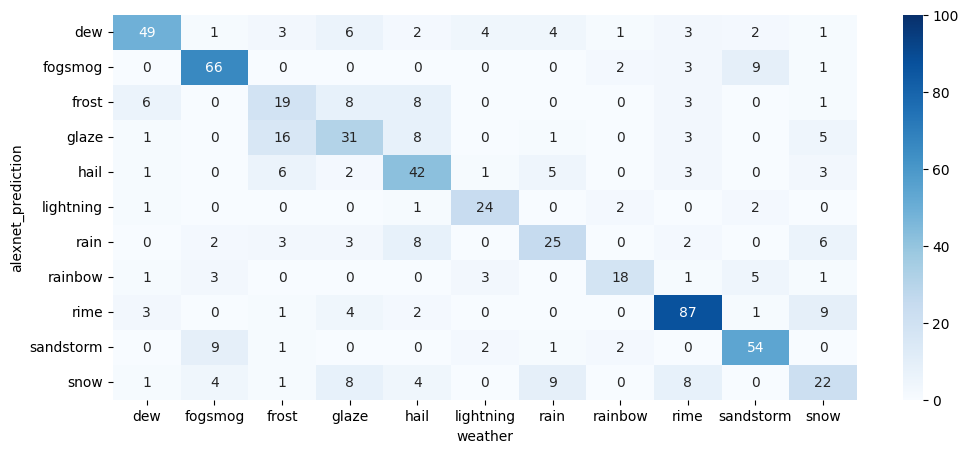

In [58]:
stack_of_all_steps(
    model_name='alexnet',
    num_classes=11,
    num_epochs=25,
    batch_size=64,
    learning_rate=0.001,
    lr_decay=True,
    feature_extract=False
)

<div style='border:5px solid #5098d3; background-color:#4a93ce; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='densenet' style='font-size:17px;font-weight:bold;color:white;'>Densenet</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 93.7MB/s]


START TRAINING:
Epoch: 1


Training: 100%|██████████| 158/158 [01:52<00:00,  1.40it/s]


Training loss: 1.6570,           Training accuracy: 4438/10062 (44.107%)

Validation loss: 1.2041,           Validation Accuracy: 425/674 (63.056%)

Epoch: 2


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.2813,           Training accuracy: 5606/10062 (55.715%)

Validation loss: 1.0302,           Validation Accuracy: 443/674 (65.727%)

Epoch: 3


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.1918,           Training accuracy: 5945/10062 (59.084%)

Validation loss: 0.9927,           Validation Accuracy: 451/674 (66.914%)

Epoch: 4


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.1419,           Training accuracy: 6083/10062 (60.455%)

Validation loss: 0.9090,           Validation Accuracy: 479/674 (71.068%)

Epoch: 5


Training: 100%|██████████| 158/158 [01:40<00:00,  1.58it/s]


Training loss: 1.1249,           Training accuracy: 6108/10062 (60.704%)

Validation loss: 0.9460,           Validation Accuracy: 468/674 (69.436%)

Epoch: 6


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.0864,           Training accuracy: 6249/10062 (62.105%)

Validation loss: 0.9193,           Validation Accuracy: 467/674 (69.288%)

Epoch: 7


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.0804,           Training accuracy: 6271/10062 (62.324%)

Validation loss: 0.9367,           Validation Accuracy: 466/674 (69.139%)

Epoch: 8


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.0510,           Training accuracy: 6377/10062 (63.377%)

Validation loss: 0.9108,           Validation Accuracy: 465/674 (68.991%)

Epoch: 9


Training: 100%|██████████| 158/158 [01:40<00:00,  1.57it/s]


Training loss: 1.0240,           Training accuracy: 6502/10062 (64.619%)

Validation loss: 0.8808,           Validation Accuracy: 480/674 (71.217%)

Epoch: 10


Training: 100%|██████████| 158/158 [01:40<00:00,  1.58it/s]


Training loss: 1.0396,           Training accuracy: 6449/10062 (64.093%)

Validation loss: 0.8889,           Validation Accuracy: 476/674 (70.623%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.80      0.68      0.74        63
     fogsmog       0.83      0.76      0.80        85
       frost       0.50      0.68      0.58        50
       glaze       0.54      0.58      0.56        62
        hail       0.75      0.61      0.68        75
   lightning       0.89      0.94      0.91        34
        rain       0.61      0.76      0.67        45
     rainbow       0.72      0.72      0.72        25
        rime       0.81      0.72      0.76       113
   sandstorm       0.67      0.75      0.71        73
        snow       0.47      0.45      0.46        49

    accuracy                           0.69       674
   macro avg       0.69      0.70      0.69       674
weight

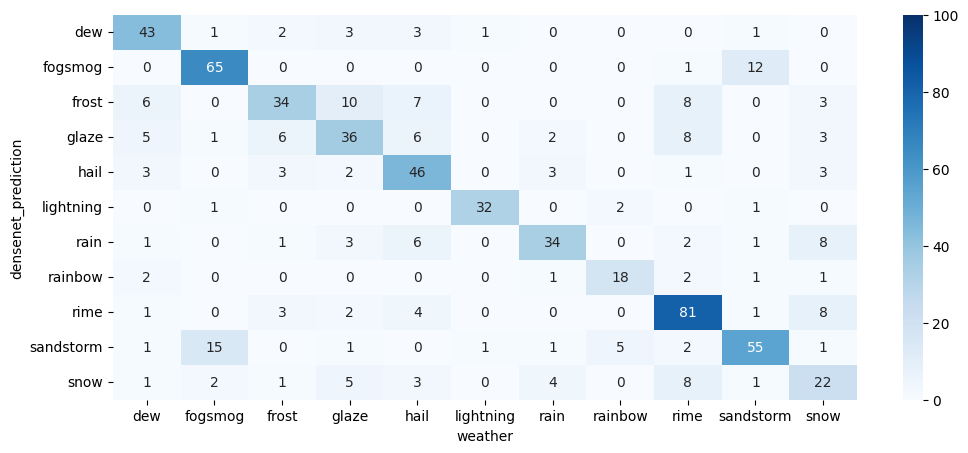

In [35]:
stack_of_all_steps(
    model_name='densenet',            
    num_classes=11, 
    num_epochs=10, 
    batch_size=64, 
    learning_rate=0.001, 
    lr_decay=True,
    feature_extract=True
)

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 164MB/s] 


START TRAINING:
Epoch: 1


Training: 100%|██████████| 79/79 [04:18<00:00,  3.28s/it]


Training loss: 1.1809,           Training accuracy: 5884/10062 (58.477%)

Validation loss: 1.0303,           Validation Accuracy: 455/674 (67.507%)

Epoch: 2


Training: 100%|██████████| 79/79 [04:15<00:00,  3.24s/it]


Training loss: 0.8656,           Training accuracy: 6993/10062 (69.499%)

Validation loss: 0.8804,           Validation Accuracy: 484/674 (71.810%)

Epoch: 3


Training: 100%|██████████| 79/79 [04:14<00:00,  3.22s/it]


Training loss: 0.7527,           Training accuracy: 7402/10062 (73.564%)

Validation loss: 0.8713,           Validation Accuracy: 493/674 (73.145%)

Epoch: 4


Training: 100%|██████████| 79/79 [04:14<00:00,  3.22s/it]


Training loss: 0.6759,           Training accuracy: 7660/10062 (76.128%)

Validation loss: 0.9543,           Validation Accuracy: 491/674 (72.849%)

Epoch: 5


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training loss: 0.6220,           Training accuracy: 7861/10062 (78.126%)

Validation loss: 0.8782,           Validation Accuracy: 503/674 (74.629%)

Epoch: 6


Training: 100%|██████████| 79/79 [04:12<00:00,  3.20s/it]


Training loss: 0.5596,           Training accuracy: 8078/10062 (80.282%)

Validation loss: 0.9293,           Validation Accuracy: 487/674 (72.255%)

Epoch: 7


Training: 100%|██████████| 79/79 [04:13<00:00,  3.20s/it]


Training loss: 0.5306,           Training accuracy: 8200/10062 (81.495%)

Validation loss: 0.7940,           Validation Accuracy: 510/674 (75.668%)

Epoch: 8


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training loss: 0.3844,           Training accuracy: 8705/10062 (86.514%)

Validation loss: 0.5282,           Validation Accuracy: 562/674 (83.383%)

Epoch: 9


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training loss: 0.3253,           Training accuracy: 8937/10062 (88.819%)

Validation loss: 0.5242,           Validation Accuracy: 560/674 (83.086%)

Epoch: 10


Training: 100%|██████████| 79/79 [04:14<00:00,  3.22s/it]


Training loss: 0.2932,           Training accuracy: 9043/10062 (89.873%)

Validation loss: 0.4893,           Validation Accuracy: 565/674 (83.828%)

Epoch: 11


Training: 100%|██████████| 79/79 [04:13<00:00,  3.20s/it]


Training loss: 0.2742,           Training accuracy: 9120/10062 (90.638%)

Validation loss: 0.5137,           Validation Accuracy: 565/674 (83.828%)

Epoch: 12


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training loss: 0.2596,           Training accuracy: 9191/10062 (91.344%)

Validation loss: 0.5071,           Validation Accuracy: 574/674 (85.163%)

Epoch: 13


Training: 100%|██████████| 79/79 [04:13<00:00,  3.20s/it]


Training loss: 0.2426,           Training accuracy: 9215/10062 (91.582%)

Validation loss: 0.5341,           Validation Accuracy: 561/674 (83.234%)

Epoch: 14


Training: 100%|██████████| 79/79 [04:14<00:00,  3.22s/it]


Training loss: 0.2373,           Training accuracy: 9264/10062 (92.069%)

Validation loss: 0.5377,           Validation Accuracy: 567/674 (84.125%)

Epoch: 15


Training: 100%|██████████| 79/79 [04:15<00:00,  3.23s/it]


Training loss: 0.2172,           Training accuracy: 9313/10062 (92.556%)

Validation loss: 0.5250,           Validation Accuracy: 569/674 (84.421%)

Epoch: 16


Training: 100%|██████████| 79/79 [04:13<00:00,  3.20s/it]


Training loss: 0.2047,           Training accuracy: 9361/10062 (93.033%)

Validation loss: 0.5168,           Validation Accuracy: 568/674 (84.273%)

Epoch: 17


Training: 100%|██████████| 79/79 [04:12<00:00,  3.20s/it]


Training loss: 0.2149,           Training accuracy: 9336/10062 (92.785%)

Validation loss: 0.5103,           Validation Accuracy: 565/674 (83.828%)

Epoch: 18


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training loss: 0.2062,           Training accuracy: 9370/10062 (93.123%)

Validation loss: 0.5220,           Validation Accuracy: 574/674 (85.163%)

Epoch: 19


Training: 100%|██████████| 79/79 [04:13<00:00,  3.20s/it]


Training loss: 0.2003,           Training accuracy: 9372/10062 (93.143%)

Validation loss: 0.5264,           Validation Accuracy: 568/674 (84.273%)

Epoch: 20


Training: 100%|██████████| 79/79 [04:12<00:00,  3.20s/it]


Training loss: 0.1909,           Training accuracy: 9418/10062 (93.600%)

Validation loss: 0.5270,           Validation Accuracy: 568/674 (84.273%)

END TRAINING:

START TESTING:
END TESTING:

VISUALIZE RESULTS:
  CLASSIFICATION REPORT
              precision    recall  f1-score   support

         dew       0.91      0.95      0.93        63
     fogsmog       0.90      0.93      0.91        85
       frost       0.90      0.76      0.83        50
       glaze       0.79      0.77      0.78        62
        hail       0.96      0.93      0.95        75
   lightning       1.00      1.00      1.00        34
        rain       0.75      0.73      0.74        45
     rainbow       0.96      0.92      0.94        25
        rime       0.85      0.88      0.87       113
   sandstorm       0.92      0.89      0.90        73
        snow       0.58      0.63      0.61        49

    accuracy                           0.86       674
   macro avg       0.86      0.86      0.86       674
weight

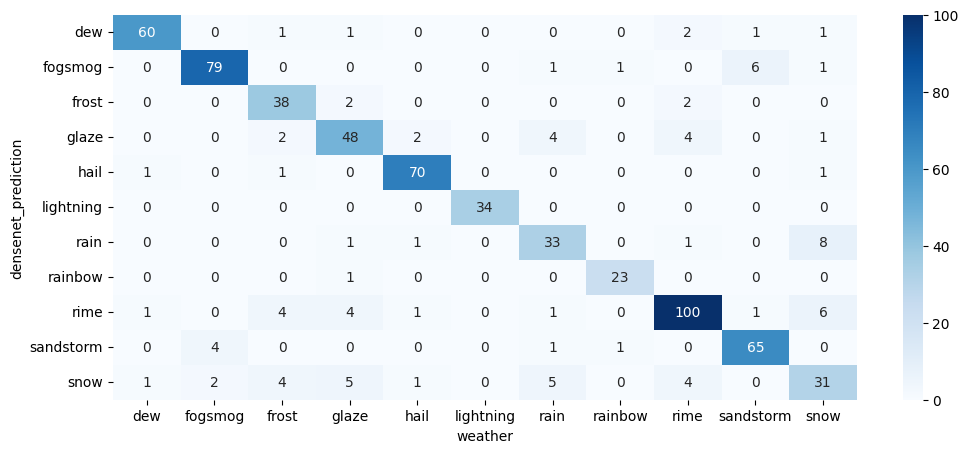

In [35]:
stack_of_all_steps(
    model_name='densenet',            
    num_classes=11, 
    num_epochs=20, 
    batch_size=128, 
    learning_rate=0.001, 
    lr_decay=True,
    feature_extract=False
)

<div style='border:5px solid #37a5fe; background-color:#37a5fe; color:white; border-radius:25px; text-align:center; font-family:cursive;'>
<h6><a id='choose' style='font-size:20px;font-weight:bold;color:white;'>Choose the Best Model</a></h6>
<a href="#1" style='color:white;font-size:15px;'><div>Back to Table of Contents</div></a>
</div>

In [98]:
# These are the results of these models on test set
model_name = [
    'Custom model', 'Resnet18', 'Resnet18', 'Resnet50', 'Resnet50', 
    'Resnet152', 'Resnet152', 'Alexnet', 'Alexnet', 'Densenet', 'Densenet'
 ]
model_type = [
    'From Scratch', 'Feature Extract', 'Fine Tune', 'Feature Extract', 'Fine Tune',
    'Feature Extract', 'Fine Tune', 'Feature Extract', 'Fine Tune', 'Feature Extract', 'Fine Tune'
]

preds = test_df.columns[7:]
accuracies = [accuracy_score(test_df['weather'], test_df[pred])*100 for pred in preds]

# put results into dataframe
results = pd.DataFrame(list(zip(model_name, model_type, accuracies)), columns =['Model Name', 'Model Type', 'Accuracy'])

In [99]:
wide_df = px.data.medals_wide()

fig = px.bar(results, x="Model Name", y="Accuracy", color="Model Type", barmode='group', title="Model Accuracies")
fig.update_layout(yaxis_range=[0, 100])

fig.show()

<p style="background-color:#000099;color:white;font-weight:bold;font-size:18px;">The model I built from scatch seems to have better accuracy than <i>Alexnet</i> without fine tuning, other than that, all other versions are superior. Also, models with only feature extraction have lower accuuracy than fine tuned version. After fine tuning, all the three <i>Resnet</i> models have similar accuracy of <b>84%</b>. On the other hand, <i>Densenet</i> has a bit higher accuracy (<b>86%</b>). Therefore, with a small margin, <i>Densenet</i> model wins the race for being the Classifier of weather classification app.</p>

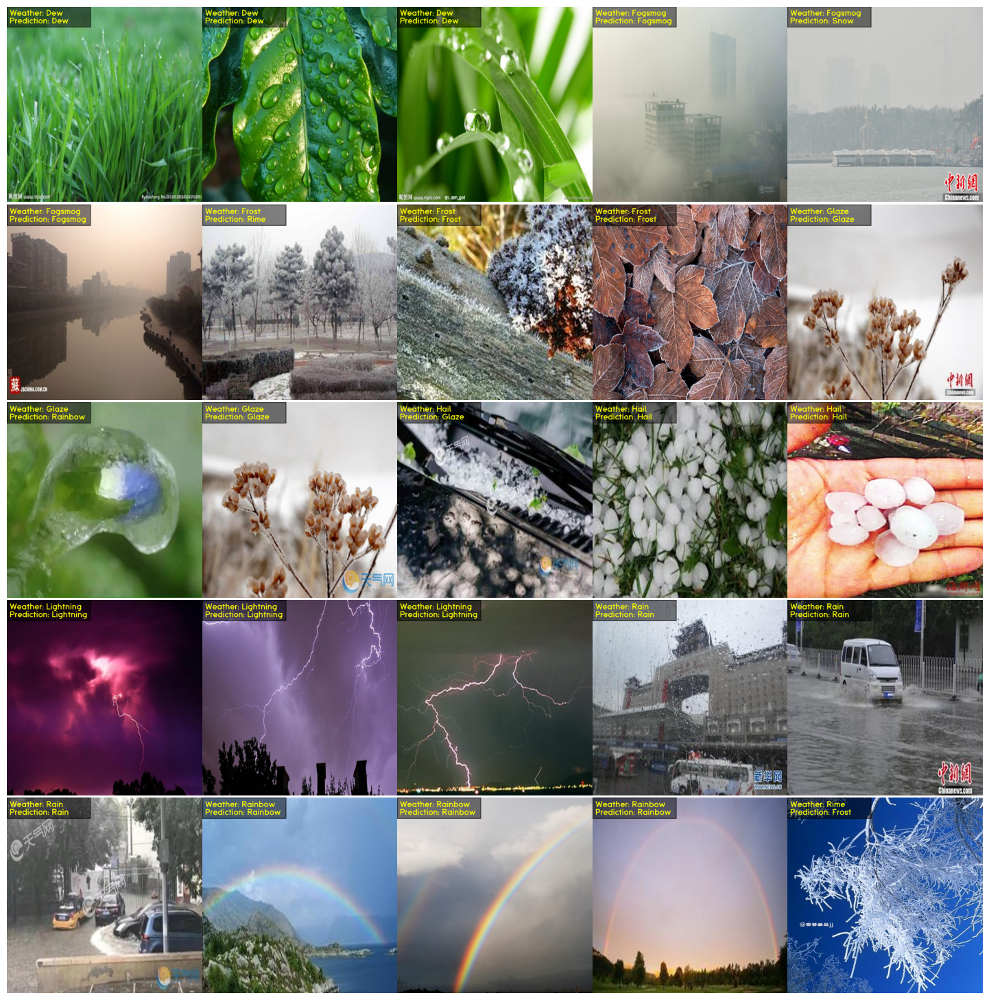

In [49]:
# Densenet predictions
pred_df = test_df[['weather', 'path', 'densenet_fine_tuned_prediction']].groupby('weather').sample(3, random_state=42)
image_plots(pred_df, 5, 5, 15, 15, show_resolution=False, show_prediction=True, prediction_column='densenet_fine_tuned_prediction')